In [1]:
import os
import cv2
import math
import glob
import shutil
import random
import itertools

import numpy as np
import pandas as pd


from matplotlib import pyplot as plt
from PIL import Image, ImageDraw, ImageFont

from Roots_point_detect_tool import *
from pattern_detection_tool import*

from tqdm.notebook import tqdm as tqdm

In [2]:
os_sys = '/root/notebooks/'

In [3]:
json_file_list = glob.glob('../Data/patient_folder/*/*/*.json')
print(len(json_file_list))
dest_folder = os_sys+'tooth_project/tooth_xray_segmention/PBL_detection/6_result_with_label'

for json_path in tqdm(json_file_list):
    src_files = json_path
    dest_path = os.path.join(dest_folder, json_path.split('/')[-1])
    shutil.copyfile(src_files, dest_path)

159


In [4]:
import os
import shutil

def remove_check_point(path):
    for file_name in os.listdir(path):
        #print(file_name)
        if 'checkpoints' in file_name:
            shutil.rmtree(os.path.join(path, file_name))
        if '__pycache__' in file_name:
            shutil.rmtree(os.path.join(path, file_name))

In [5]:
parent_folder_path = os_sys+'tooth_project/tooth_xray_segmention/PBL_detection'
remove_check_point(parent_folder_path)

for folder_name in tqdm(sorted(os.listdir(parent_folder_path)), total = len(os.listdir(parent_folder_path))):
    if os.path.isdir(os.path.join(parent_folder_path, folder_name)):
        remove_check_point(os.path.join(parent_folder_path, folder_name))
        print('Find {} files in [{}] folder'.format(len(os.listdir(os.path.join(parent_folder_path, folder_name))),folder_name))

Find 199 files in [1_o_image] folder
Find 199 files in [1_roots_unet_mask] folder
Find 199 files in [1_seg_image] folder
Find 815 files in [2_roots_unet_mask_components] folder
Find 478 files in [3_fill_up_tooth_by_root] folder
Find 478 files in [4_seg_img_with_cej] folder
Find 473 files in [5_draw_all_points_on_o_img] folder
Find 473 files in [5_draw_all_points_on_seg_img] folder
Find 473 files in [5_pattern_detection_result] folder
Find 632 files in [6_result_with_label] folder
Find 2 files in [Resut_comparison] folder
Find 5 files in [csv_file] folder



#### In 1_ is 
- 1.Original image.
- 2.Unet find root image.
- 3.Unet 3 class segmentation.

#### In 2_ is 
- 1.Split all color block in root image to image_name_x.
- 2.So one image would become many images.

#### In 3_ 826-469=357 
- 1.If 2_ non_zero pixel < 5000 or abs(slope(moment of inertia)) < 1.5 would filter out.
- 2.Filled up the remaining image by it's moment of inertia scale by it's hight and width.
- 3.Using segmentaiton tooth class (green pixel) to be mask to modify the over area filled up tooth.

#### In 4_ paste the 2_ image in segmentation image  
- 1.If 2_ non_zero pixel < 5000 or abs(slope(moment of inertia)) < 1.5 would filter out.
- 2.The remaining root would be paste on segmentation image

#### In 5_ using 

In [6]:
Match_result_csv_path = os.path.join(parent_folder_path,'csv_file/PBL_match_result.csv')
Match_result_csv = pd.read_csv(Match_result_csv_path)


In [7]:
# def write_info_on_image(image_path,tabel,save_path,count):
#     image_name = get_name_from_path(image_path,True)
#     image_name_False = get_name_from_path(image_path,False)
#     #print(image_name)
#     image_shape = cv2.imread(image_path).shape
#     image = Image.open(image_path)
#     draw = ImageDraw.Draw(image)
#     if image_shape[1]<600:
#         font = ImageFont.truetype('Roboto-Bold.ttf', size=25)
#     else:
#         font = ImageFont.truetype('Roboto-Bold.ttf', size=35)
#     (x, y) = (20, 10)
#     error_ = False
#     error_value = None
#     if not tabel.loc[(tabel['tooth_path'] == '{}'.format(image_name))].empty:
#         tooth_name = tabel.loc[(tabel['tooth_path'] == '{}'.format(image_name))]['PBL_predict_tooth'].values[0].split('_')[0]
#         #print(tooth_name)
#         try:
#             LPBL = tabel.loc[(tabel['tooth_path'] == '{}'.format(image_name)) & (tabel['PBL_predict_tooth'].isin(['{}_L'.format(tooth_name)]))]['PBL_value'].values[0]
#             L_predict_stage = tabel.loc[(tabel['tooth_path'] == '{}'.format(image_name)) & (tabel['PBL_predict_tooth'].isin(['{}_L'.format(tooth_name)]))]['PBL_stage'].values[0]
#             L_Label_stage = tabel.loc[(tabel['tooth_path'] == '{}'.format(image_name)) & (tabel['PBL_predict_tooth'].isin(['{}_L'.format(tooth_name)]))]['state'].values[0]
#         except:
#             LPBL = -888
#             L_predict_stage = -888
#             L_Label_stage = -888
#         try:
#             RPBL = tabel.loc[(tabel['tooth_path'] == '{}'.format(image_name)) & (tabel['PBL_predict_tooth'].isin(['{}_R'.format(tooth_name)]))]['PBL_value'].values[0]
#             R_predict_stage = tabel.loc[(tabel['tooth_path'] == '{}'.format(image_name)) & (tabel['PBL_predict_tooth'].isin(['{}_R'.format(tooth_name)]))]['PBL_stage'].values[0]
#             R_Label_stage = tabel.loc[(tabel['tooth_path'] == '{}'.format(image_name)) & (tabel['PBL_predict_tooth'].isin(['{}_R'.format(tooth_name)]))]['state'].values[0]
#         except:
#             RPBL = -888
#             R_predict_stage = -888
#             R_Label_stage = -888
#         #print(L_predict_stage,R_predict_stage,L_Label_stage,R_Label_stage)
#         if L_predict_stage != L_Label_stage or R_predict_stage != R_Label_stage:
#             error_ = True
#             if L_predict_stage == -999 and L_Label_stage != -999:
#                 error_value = 11##human can find model can't
#             elif R_predict_stage == -999 and R_Label_stage != -999:
#                 error_value = 12##human can find model can't
#             elif L_predict_stage == -999 and L_Label_stage != -999 and R_predict_stage == -999 and R_Label_stage != -999:
#                 error_value = 1##human can find model can't
#             elif L_predict_stage != -999 and L_Label_stage == -999:
#                 error_value = 21##model can find human can't
#             elif R_predict_stage != -999 and R_Label_stage == -999:
#                 error_value = 22##model can find human can't
#             elif L_predict_stage != -999 and L_Label_stage == -999 and R_predict_stage != -999 and R_Label_stage == -999:
#                 error_value = 2##model can find human can't
#             elif L_predict_stage == -888 and L_Label_stage == -888:
#                 error_value = 31##one PBL = -888
#             elif R_predict_stage == -888 and R_Label_stage == -888:
#                 error_value = 32##one PBL = -888
#             elif L_predict_stage == -888 and L_Label_stage == -888 and R_predict_stage == -888 and R_Label_stage == -888:
#                 error_value = 3##one PBL = -888
#             elif L_predict_stage != -999 and L_predict_stage != -888 and L_Label_stage != -999 and L_Label_stage != -888:
#                 error_value = 0##error_value            
#             elif R_predict_stage != -999 and R_predict_stage != -888 and R_Label_stage != -999 and R_Label_stage != -888:
#                 error_value = 0##error_value            
#             elif L_predict_stage != -999 and L_predict_stage != -888 and L_Label_stage != -999 and L_Label_stage != -888 and R_predict_stage != -999 and R_predict_stage != -888 and R_Label_stage != -999 and R_Label_stage != -888:
#                 error_value = 0##error_value  
#             else:
#                 print('class error!!!')
#                 print(L_predict_stage,L_Label_stage,R_predict_stage,R_Label_stage)
#         message = "LPBL:{}% P_S:{} L_S:{}\nRPBL:{}% P_S:{} L_S:{}".format(round(float(LPBL),2),int(L_predict_stage),int(L_Label_stage),round(float(RPBL),2),int(R_predict_stage),int(R_Label_stage))
#         color = 'rgb(255, 0, 0)'
#         draw.text((x, y), message, fill=color, font=font)
#     else:
#         count+=1
#         pass
#     if error_:
#         #print(error_value)
#         if error_value ==0:
#             image.save(os.path.join(save_path,image_name_False+'_err00.PNG'))
#         elif error_value ==1:
#             image.save(os.path.join(save_path,image_name_False+'_err10.PNG'))
#         elif error_value ==11:
#             image.save(os.path.join(save_path,image_name_False+'_err11.PNG'))
#         elif error_value ==12:
#             image.save(os.path.join(save_path,image_name_False+'_err12.PNG'))
#         elif error_value ==2:
#             image.save(os.path.join(save_path,image_name_False+'_err20.PNG'))
#         elif error_value ==21:
#             image.save(os.path.join(save_path,image_name_False+'_err21.PNG'))
#         elif error_value ==22:
#             image.save(os.path.join(save_path,image_name_False+'_err22.PNG'))
#         elif error_value ==3:
#             image.save(os.path.join(save_path,image_name_False+'_err30.PNG'))
#         elif error_value ==31:
#             image.save(os.path.join(save_path,image_name_False+'_err31.PNG'))
#         elif error_value ==32:
#             image.save(os.path.join(save_path,image_name_False+'_err32.PNG'))
#         else:
#             print('error_value error')
#     else:
#         image.save(os.path.join(save_path,image_name_False+'.PNG'))
#     return count

In [8]:
def write_info_on_image(image_path,tabel,save_path,count):
    image_name = get_name_from_path(image_path,True)
    #print(image_name)
    image_name_False = get_name_from_path(image_path,False)
    #print(image_name)
    image_shape = cv2.imread(image_path).shape
    image = Image.open(image_path)
    draw = ImageDraw.Draw(image)
    if image_shape[1]<600:
        font = ImageFont.truetype('Roboto-Bold.ttf', size=25)
    else:
        font = ImageFont.truetype('Roboto-Bold.ttf', size=35)
    (x, y) = (20, 10)
    error_ = False
    error_value = None
    if not tabel.loc[(tabel['tooth_path'] == '{}'.format(image_name))].empty:
        tooth_name = tabel.loc[(tabel['tooth_path'] == '{}'.format(image_name))]['PBL_predict_tooth'].values[0].split('_')[0]
        #print(tooth_name)
        try:
            LPBL = tabel.loc[(tabel['tooth_path'] == '{}'.format(image_name)) & (tabel['PBL_predict_tooth'].isin(['{}_L'.format(tooth_name)]))]['PBL_value'].values[0]
            L_predict_stage = tabel.loc[(tabel['tooth_path'] == '{}'.format(image_name)) & (tabel['PBL_predict_tooth'].isin(['{}_L'.format(tooth_name)]))]['PBL_stage'].values[0]
            L_Label_stage = tabel.loc[(tabel['tooth_path'] == '{}'.format(image_name)) & (tabel['PBL_predict_tooth'].isin(['{}_L'.format(tooth_name)]))]['state'].values[0]
            #print(L_predict_stage,L_Label_stage)
            LPBL = float(LPBL)
            L_predict_stage = float(L_predict_stage)
            L_Label_stage = float(L_Label_stage)
            #print('Left side get')
        except:
            #print('Left side No_match')
            LPBL = -888
            L_predict_stage = -888
            L_Label_stage = -888
        try:
            RPBL = tabel.loc[(tabel['tooth_path'] == '{}'.format(image_name)) & (tabel['PBL_predict_tooth'].isin(['{}_R'.format(tooth_name)]))]['PBL_value'].values[0]
            R_predict_stage = tabel.loc[(tabel['tooth_path'] == '{}'.format(image_name)) & (tabel['PBL_predict_tooth'].isin(['{}_R'.format(tooth_name)]))]['PBL_stage'].values[0]
            R_Label_stage = tabel.loc[(tabel['tooth_path'] == '{}'.format(image_name)) & (tabel['PBL_predict_tooth'].isin(['{}_R'.format(tooth_name)]))]['state'].values[0]
            #print(R_predict_stage,R_Label_stage)
            RPBL = float(RPBL)
            R_predict_stage = float(R_predict_stage)
            R_Label_stage = float(R_Label_stage)
            #print('Rright side get')
        except:
            #print('Rright side No_match')
            RPBL = -888
            R_predict_stage = -888
            R_Label_stage = -888
        #print(L_predict_stage,L_Label_stage,R_predict_stage,R_Label_stage,error_value)
        message = "LPBL:{}% P_S:{} L_S:{}\nRPBL:{}% P_S:{} L_S:{}".format(round(float(LPBL),2),int(L_predict_stage),int(L_Label_stage),round(float(RPBL),2),int(R_predict_stage),int(R_Label_stage))
        color = 'rgb(255, 0, 0)'
        draw.text((x, y), message, fill=color, font=font)
        if (L_predict_stage != L_Label_stage) or (R_predict_stage != R_Label_stage):
            error_ = True
            if (L_predict_stage == -999 and L_Label_stage != -999) or (R_predict_stage == -999 and R_Label_stage != -999):
                error_value = 1##human can find model can't
                #print('err1')
                image.save(os.path.join(save_path,image_name_False+'_err1.PNG'))
            elif (L_predict_stage != -999 and L_Label_stage == -999) or (R_predict_stage != -999 and R_Label_stage == -999):
                error_value = 2##model can find human can't
                #print('err2')
                image.save(os.path.join(save_path,image_name_False+'_err2.PNG'))
            elif (L_predict_stage == -888 and L_Label_stage == -888) or (R_predict_stage == -888 and R_Label_stage == -888):
                error_value = 3##have loss side of tooth
                #print('err3')
                image.save(os.path.join(save_path,image_name_False+'_err3.PNG'))
            else:
                error_value = 4
                #print('err4')
                image.save(os.path.join(save_path,image_name_False+'_err4.PNG'))
        else:
            image.save(os.path.join(save_path,image_name_False+'_same.PNG'))
    else:
        message = "no any tooth match(json false)"
        color = 'rgb(0, 0, 255)'
        draw.text((x, y), message, fill=color, font=font)
        image.save(os.path.join(save_path,image_name_False+'match_f.PNG'))

    return count

In [9]:
#Write info of all detect result on image
path = os.path.join(parent_folder_path,'5_pattern_detection_result/*.PNG')
image_path_list = glob.glob(path)
image_path_list.sort()

save_path = os.path.join(parent_folder_path,'6_result_with_label')

count = 0

for index,image_path in tqdm(enumerate(image_path_list),total=len(image_path_list)):
    count = write_info_on_image(image_path,Match_result_csv,save_path,count)
print(count)


0


473


This case is human can not predict but model can.


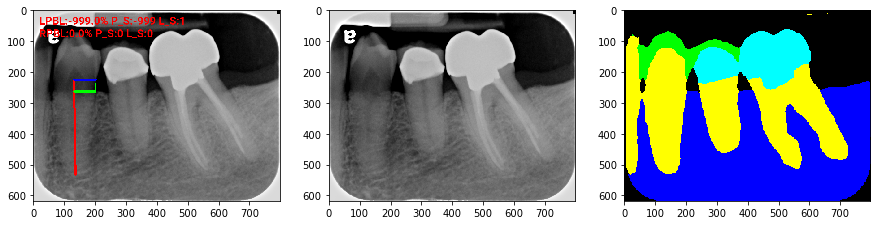

This case is human can not predict but model can.


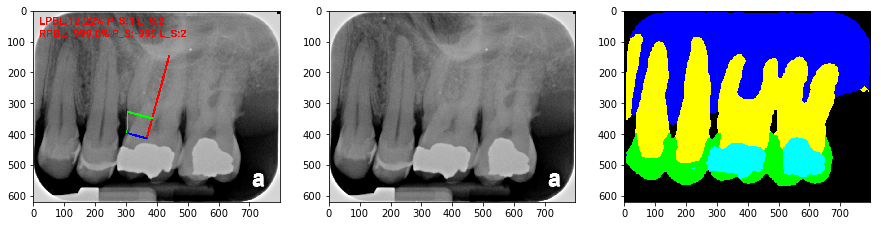

This case is human can not predict but model can.


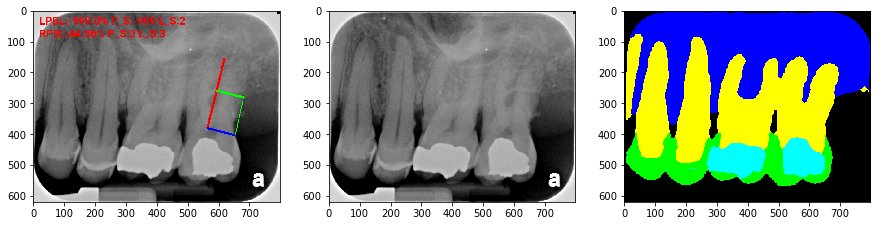

This case is human can not predict but model can.


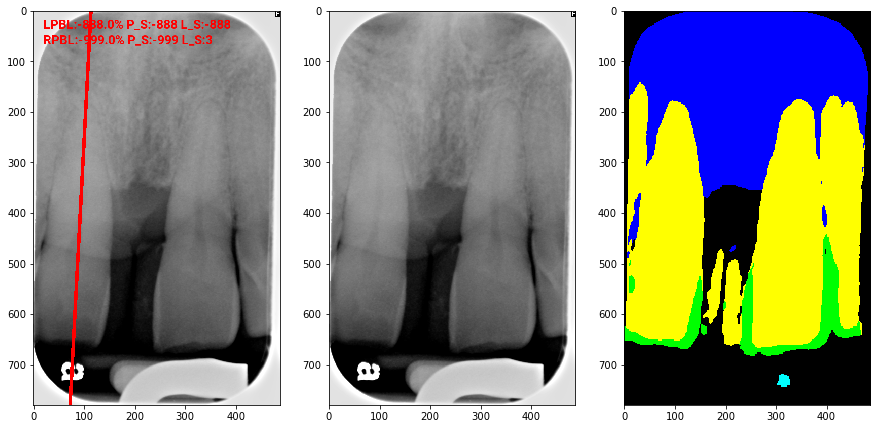

This case is human can not predict but model can.


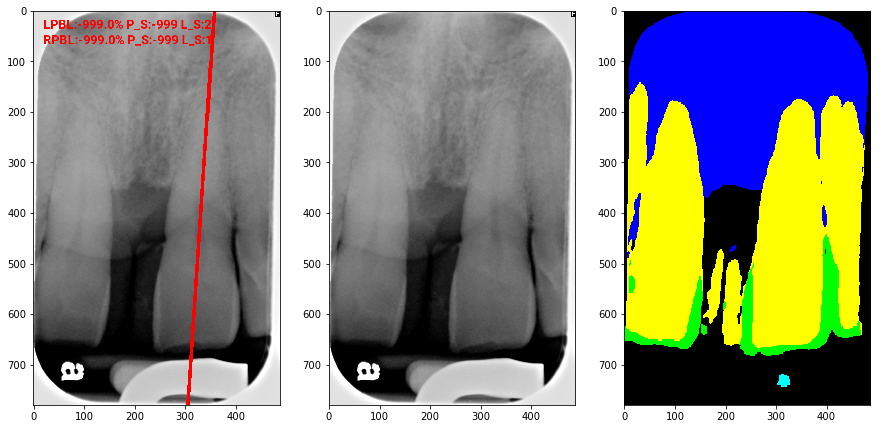

This case is human can not predict but model can.


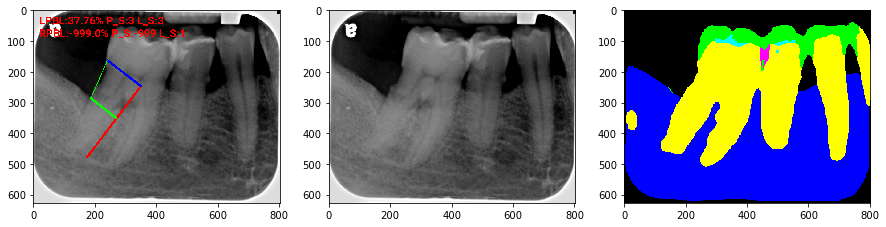

This case is human can not predict but model can.


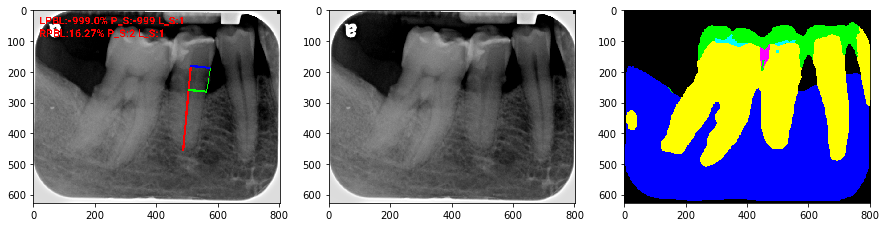

This case is human can not predict but model can.


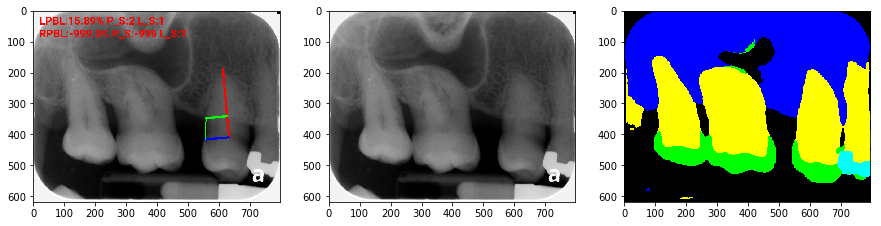

This case is human can not predict but model can.


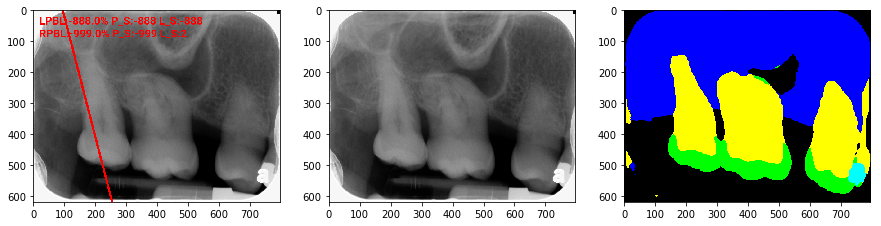

This case is human can not predict but model can.


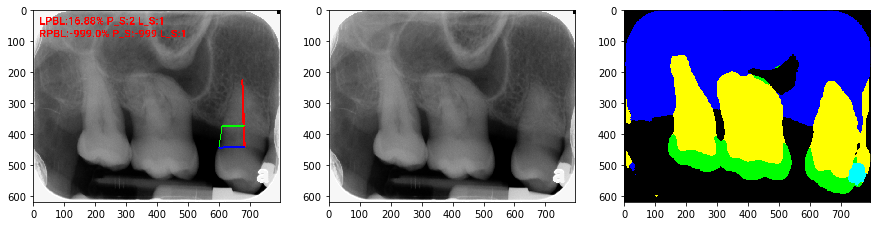

This case is human can not predict but model can.


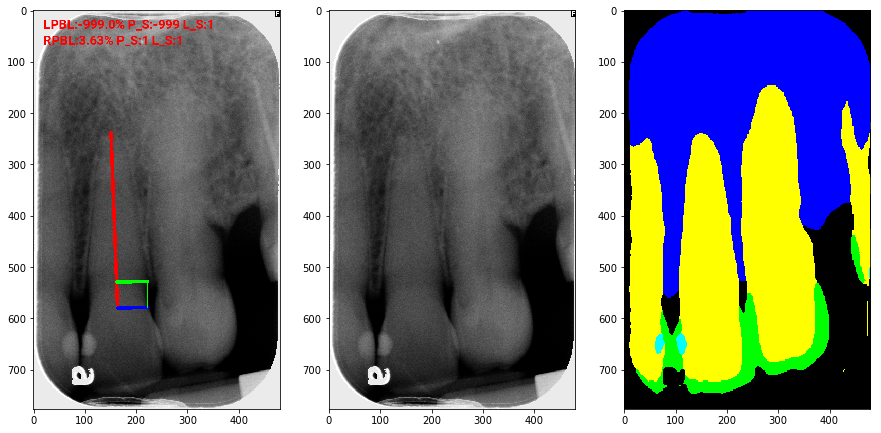

This case is human can not predict but model can.


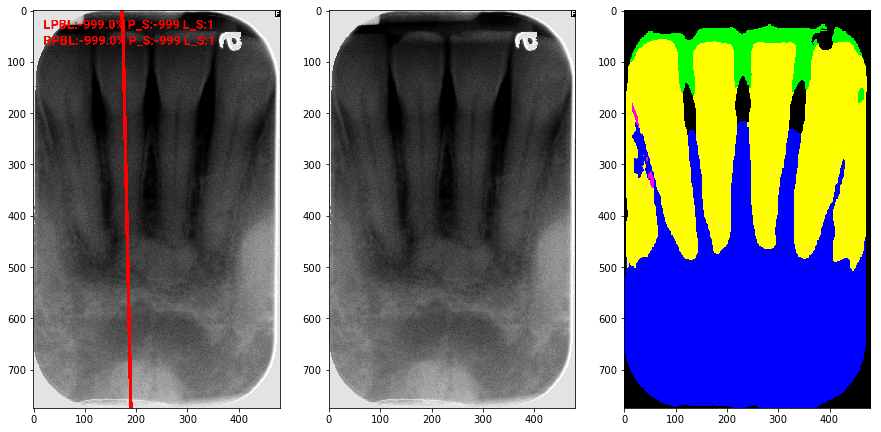

This case is human can not predict but model can.


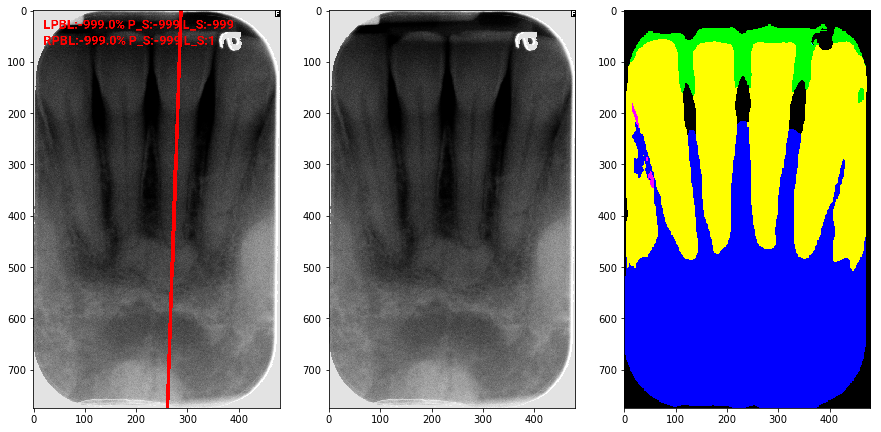

This case is human can not predict but model can.


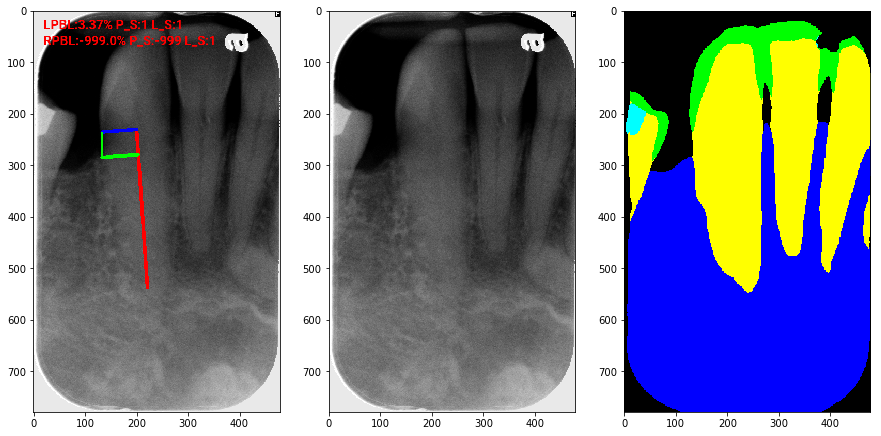

This case is human can not predict but model can.


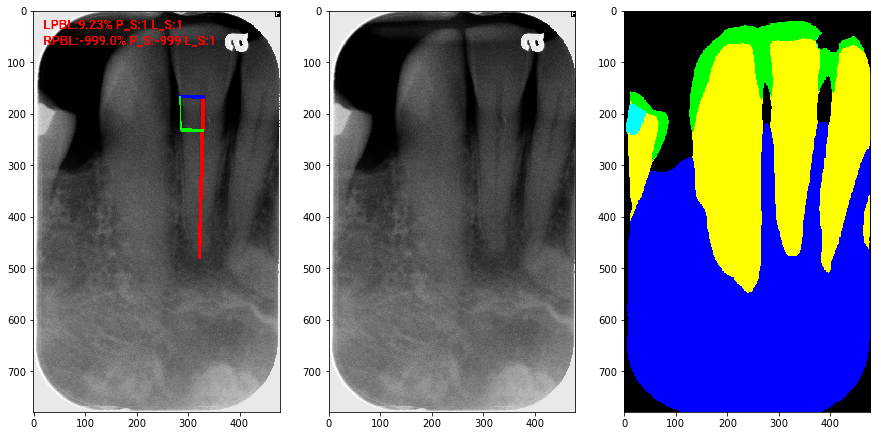

This case is human can not predict but model can.


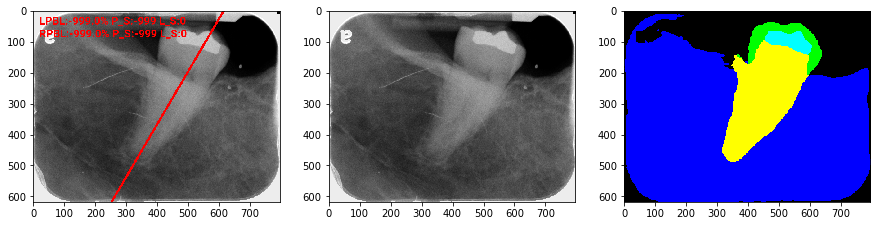

This case is human can not predict but model can.


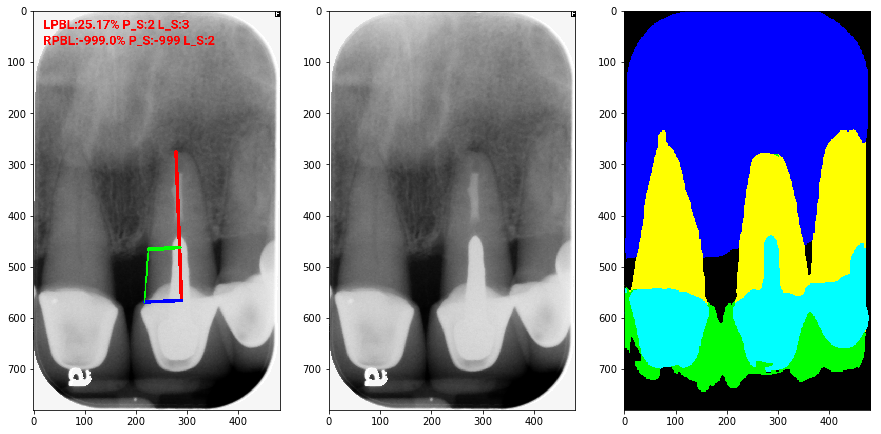

This case is human can not predict but model can.


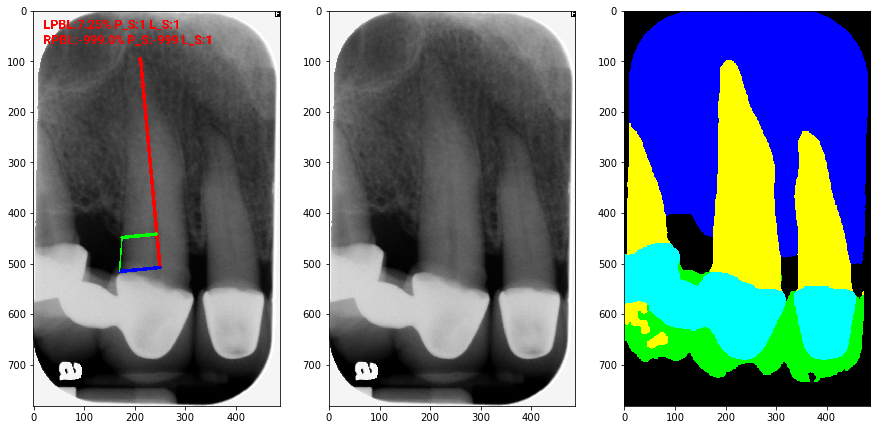

This case is human can not predict but model can.


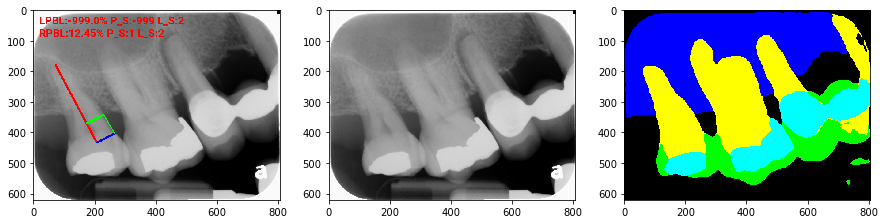

This case is human can not predict but model can.


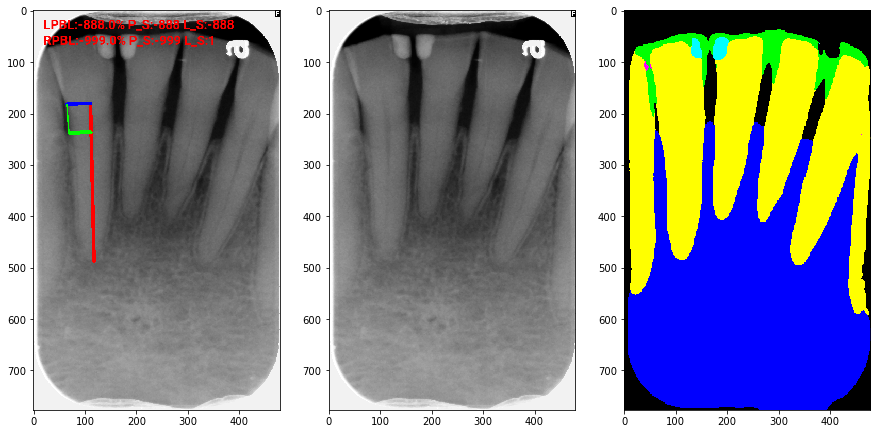

This case is human can not predict but model can.


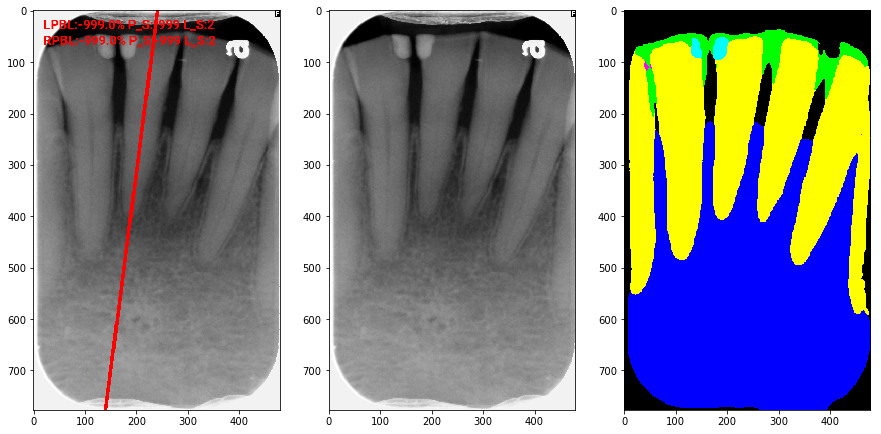

This case is human can not predict but model can.


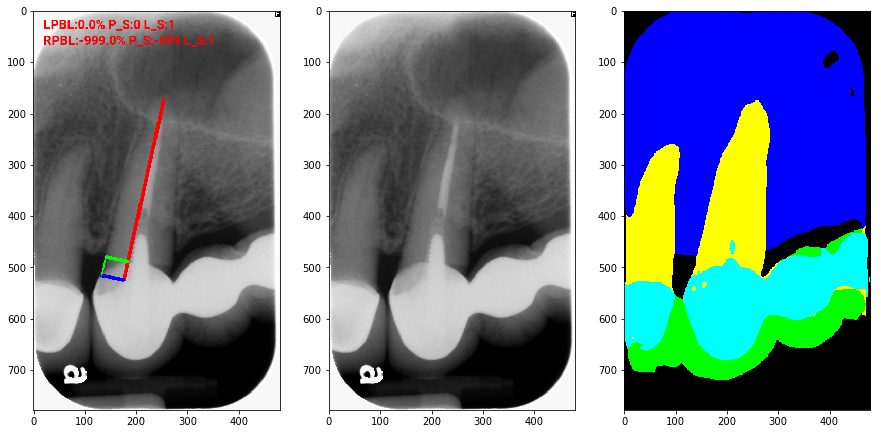

This case is human can not predict but model can.


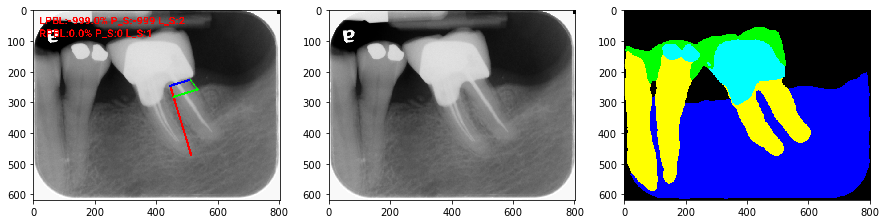

This case is human can not predict but model can.


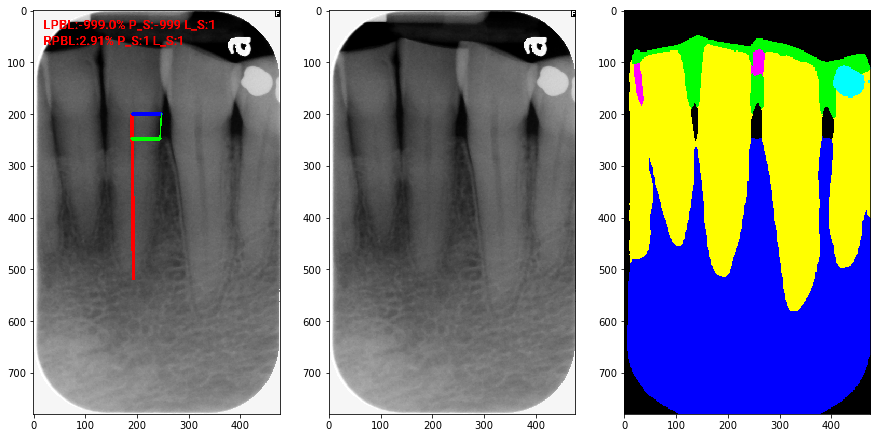

This case is human can not predict but model can.


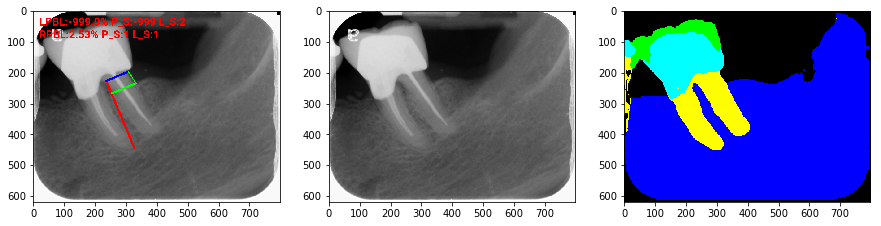

This case is human can not predict but model can.


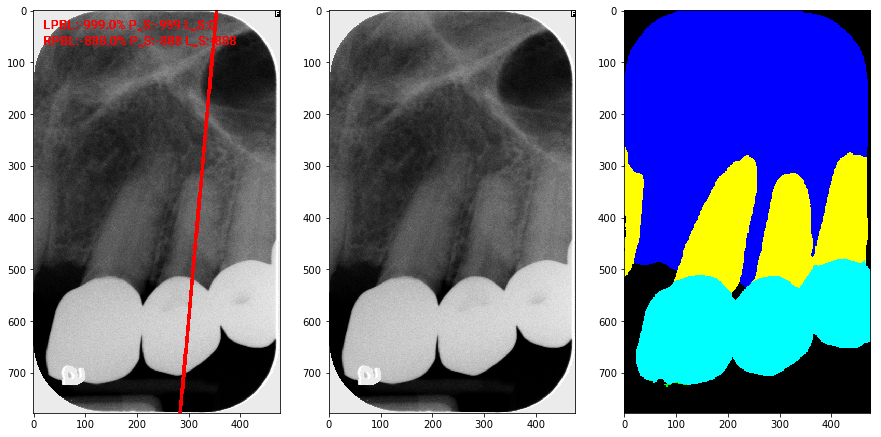

This case is human can not predict but model can.


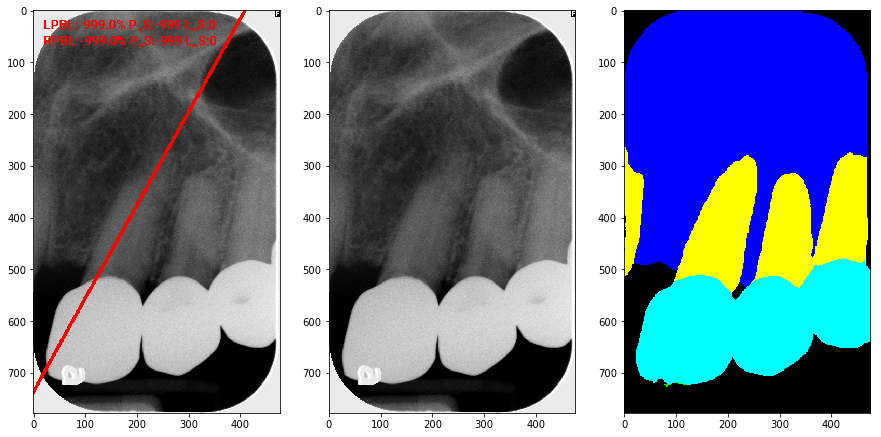

This case is human can not predict but model can.


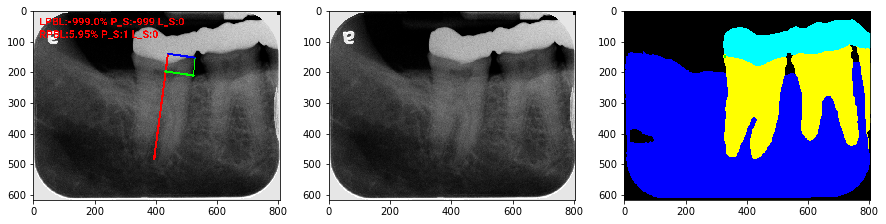

This case is human can not predict but model can.


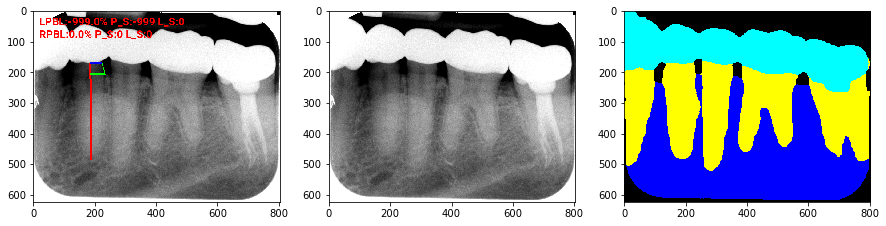

This case is human can not predict but model can.


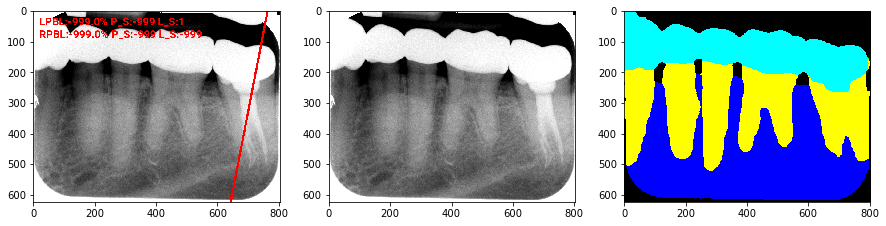

This case is human can not predict but model can.


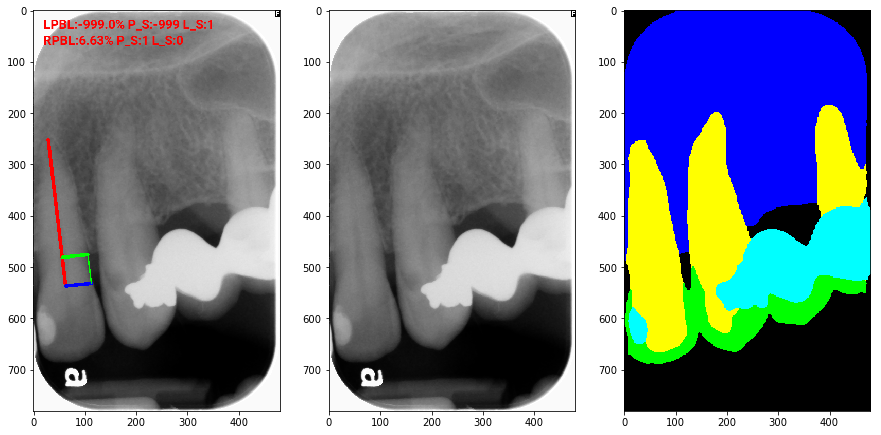

This case is human can not predict but model can.


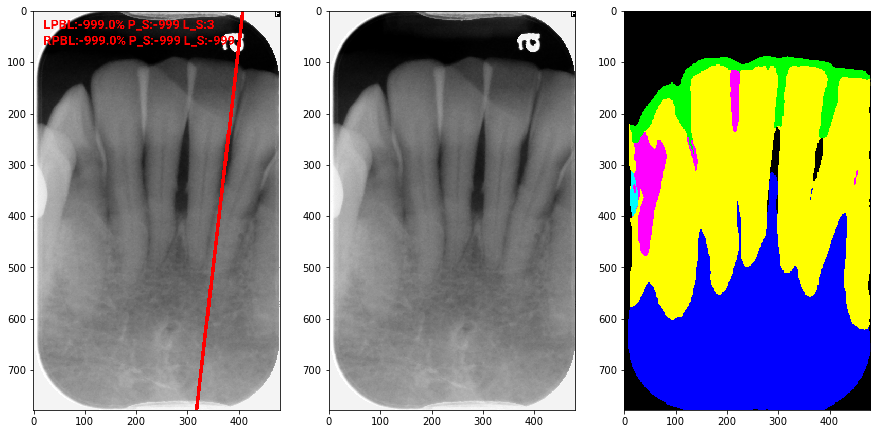

This case is human can not predict but model can.


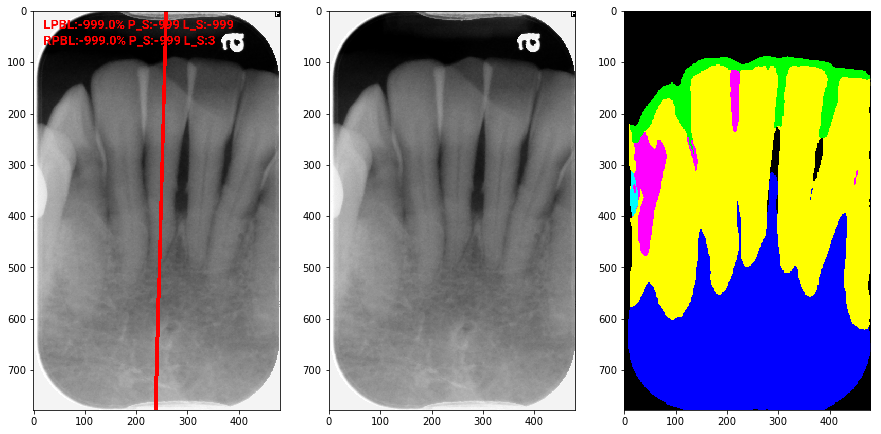

This case is human can not predict but model can.


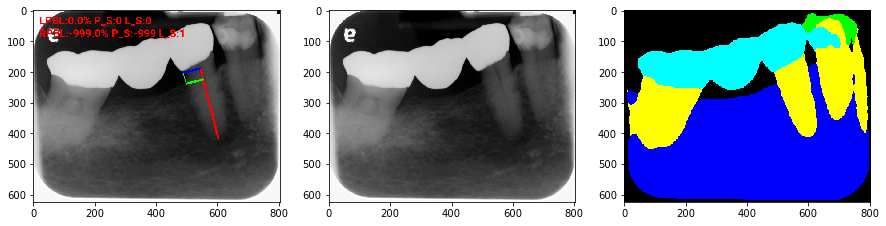

This case is human can not predict but model can.


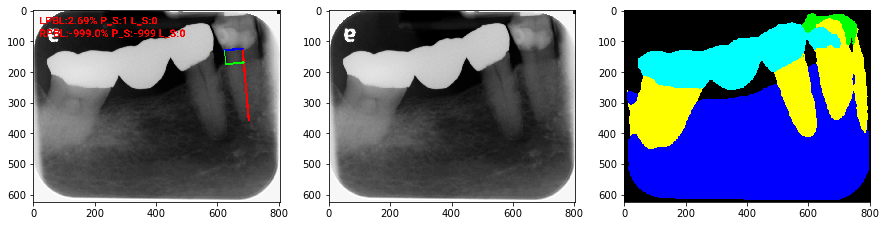

This case is human can not predict but model can.


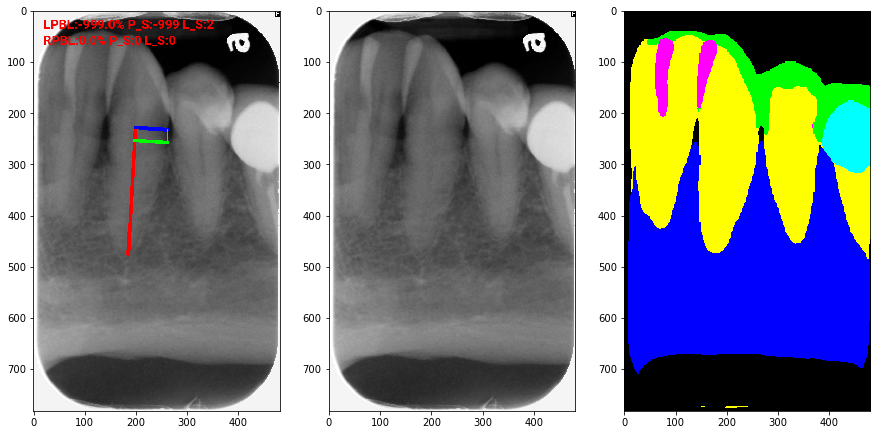

This case is human can not predict but model can.


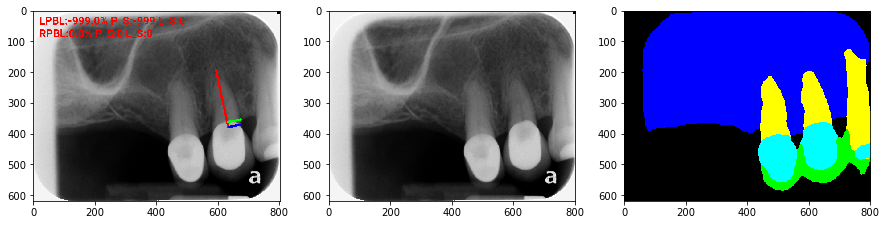

This case is human can not predict but model can.


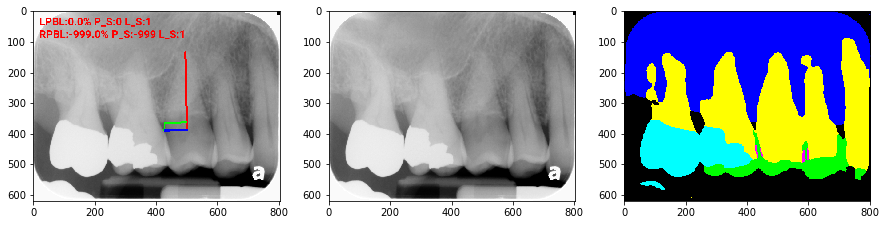

This case is human can not predict but model can.


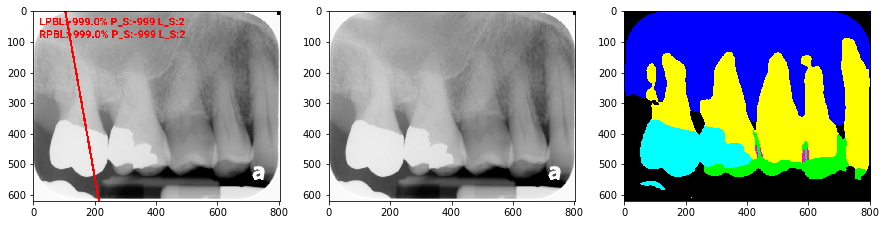

This case is human can not predict but model can.


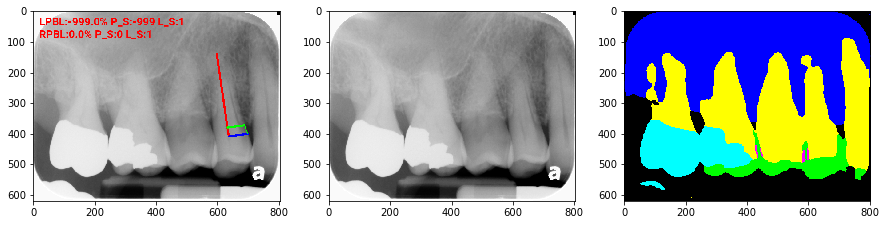

This case is human can not predict but model can.


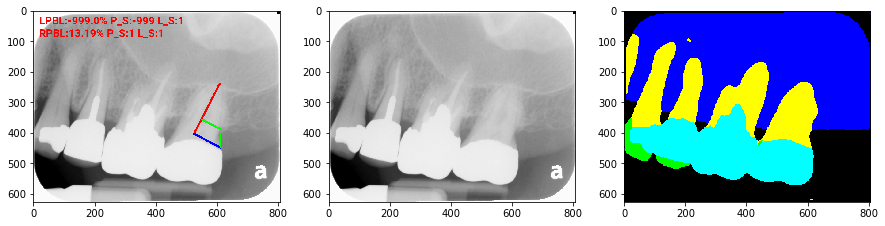

This case is human can not predict but model can.


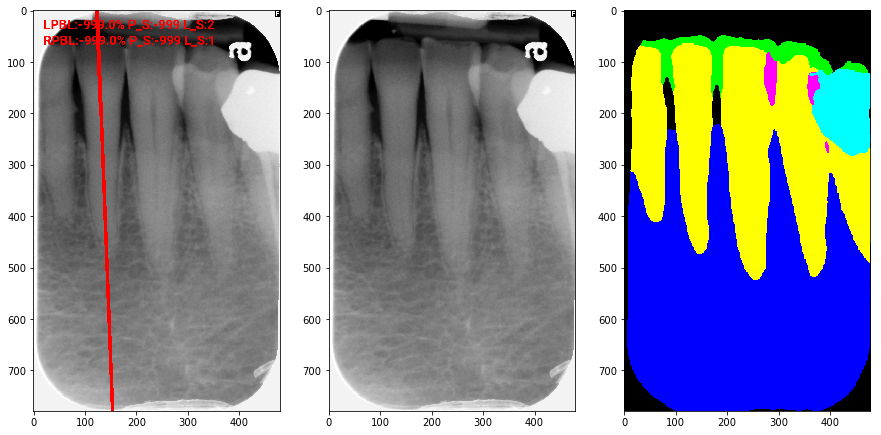

This case is human can not predict but model can.


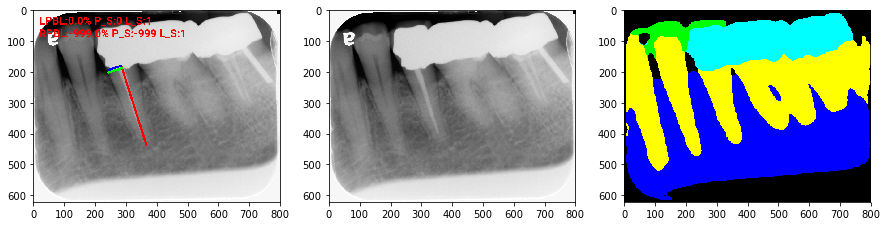

This case is human can not predict but model can.


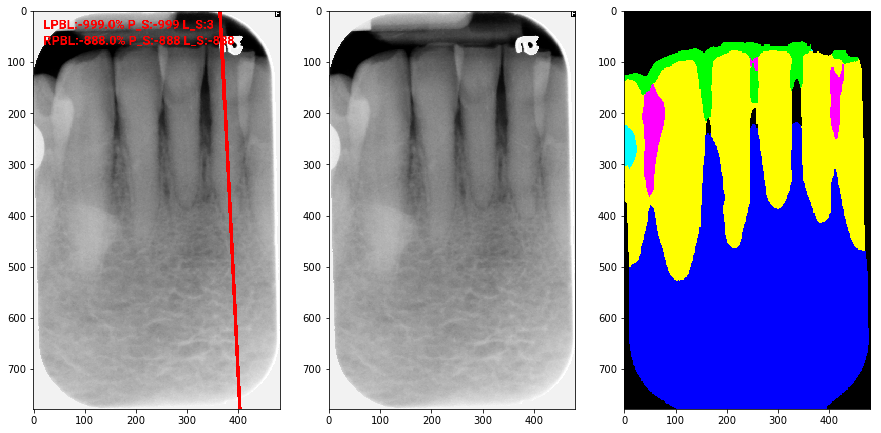

This case is human can not predict but model can.


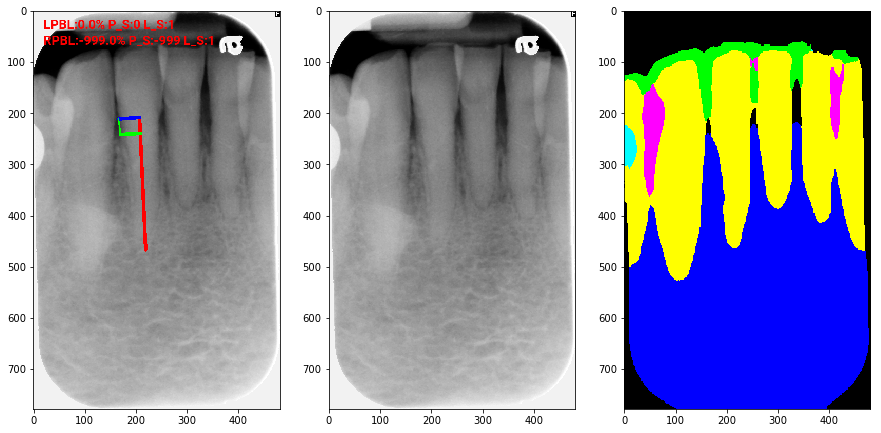

This case is human can not predict but model can.


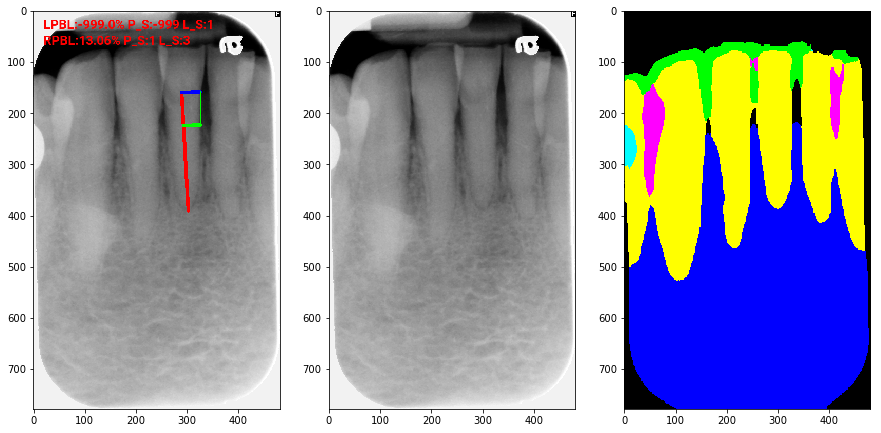

This case is human can not predict but model can.


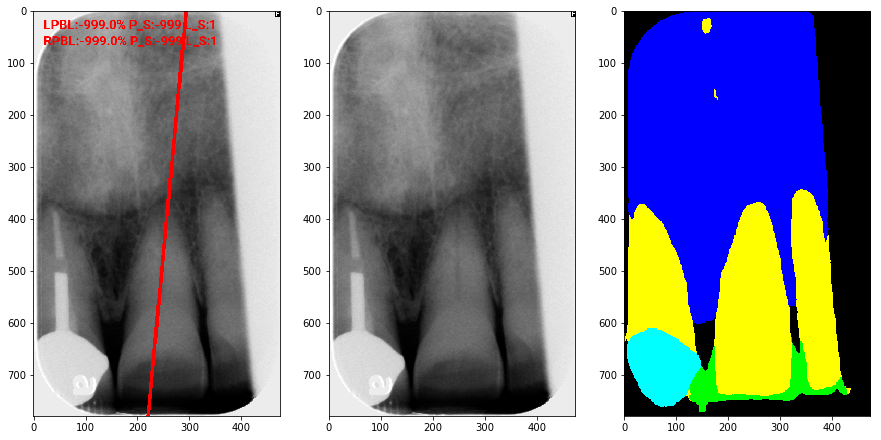

This case is human can not predict but model can.


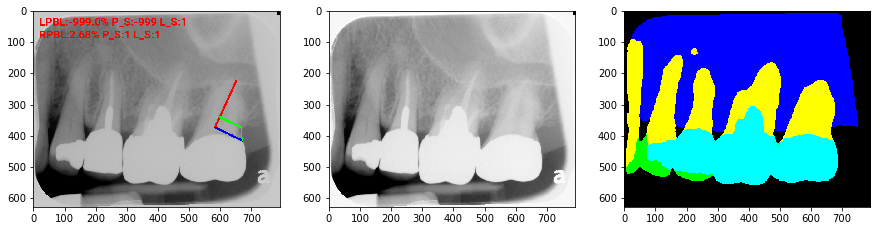

This case is human can not predict but model can.


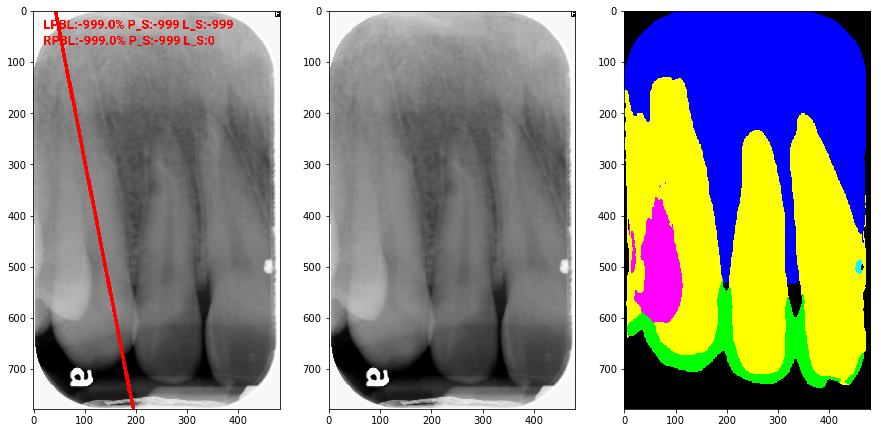

This case is human can not predict but model can.


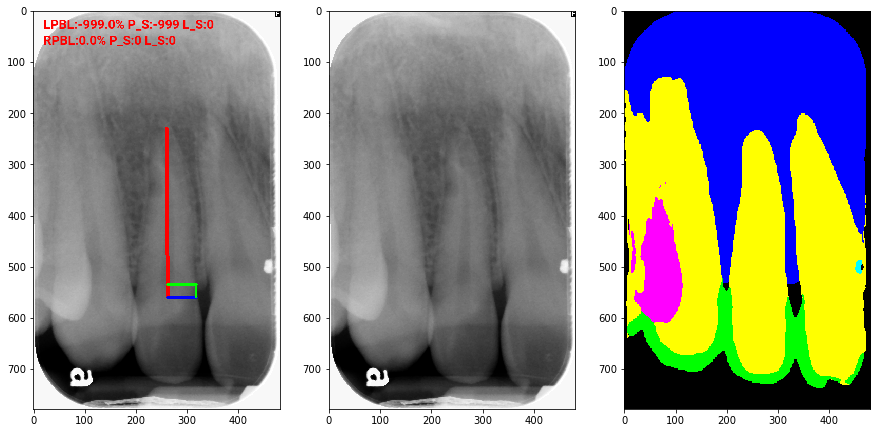

This case is human can not predict but model can.


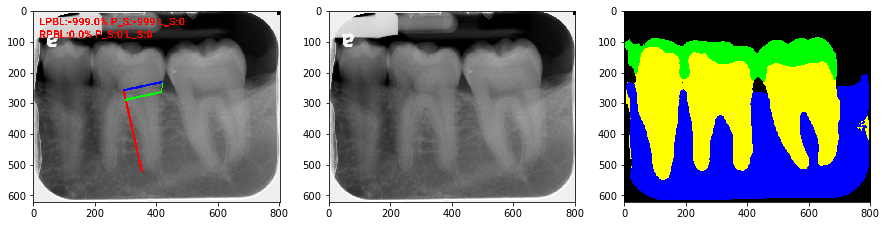

This case is human can not predict but model can.


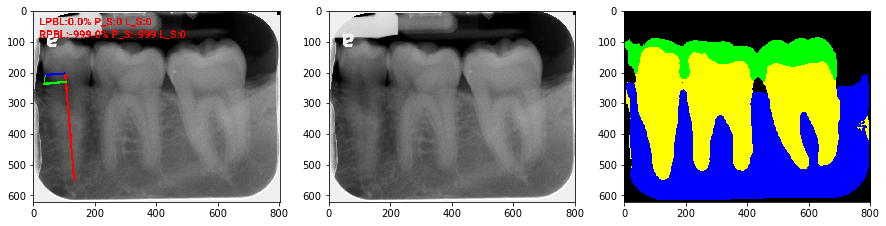

This case is human can not predict but model can.


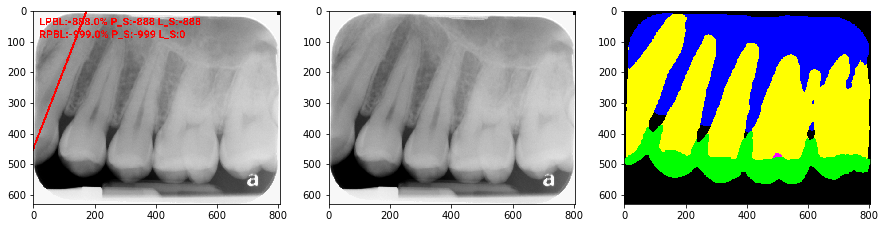

This case is human can not predict but model can.


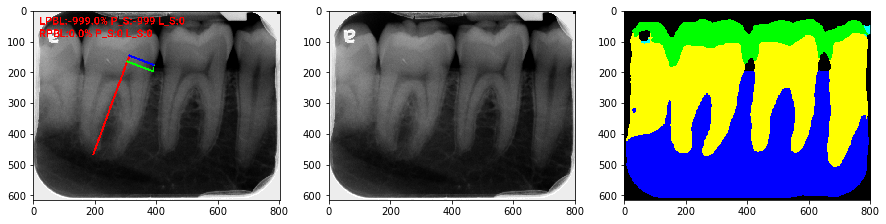

This case is human can not predict but model can.


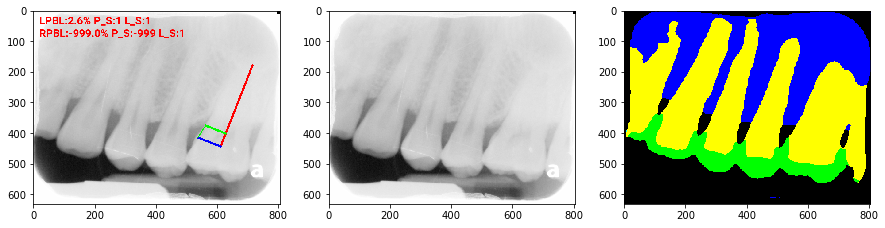

This case is human can not predict but model can.


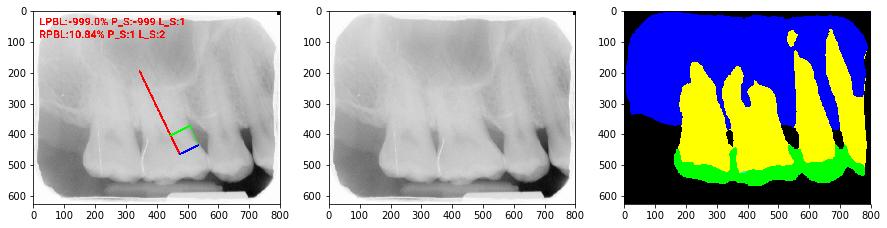

This case is human can not predict but model can.


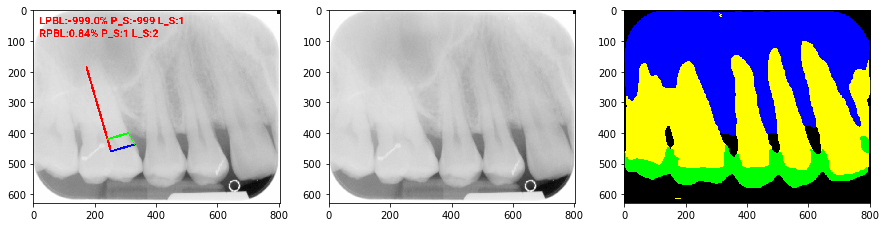

This case is human can not predict but model can.


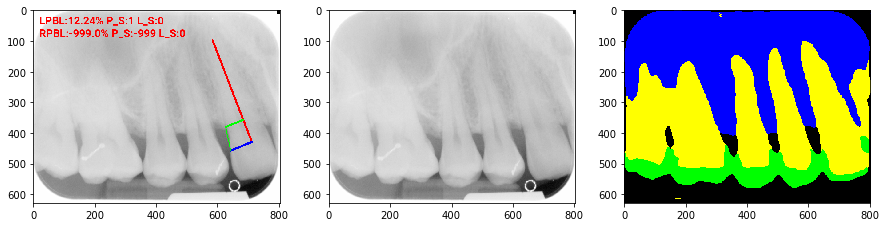

This case is human can not predict but model can.


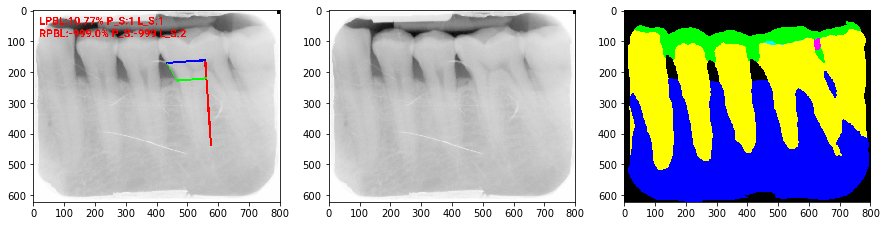

This case is human can not predict but model can.


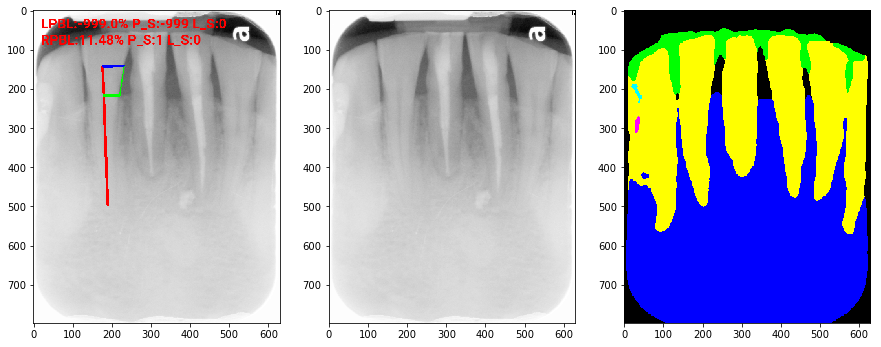

This case is human can not predict but model can.


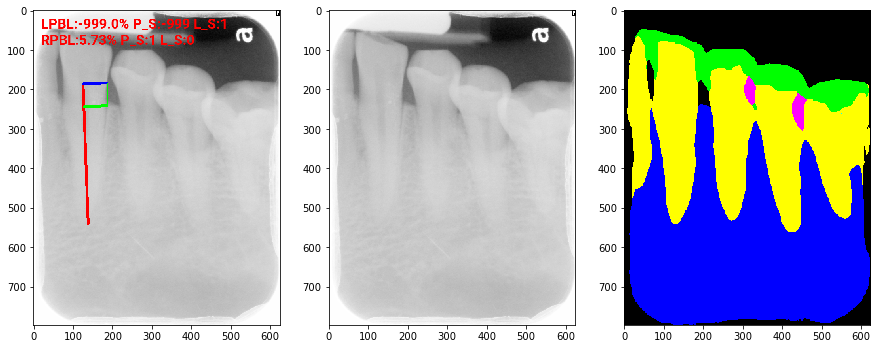

This case is human can not predict but model can.


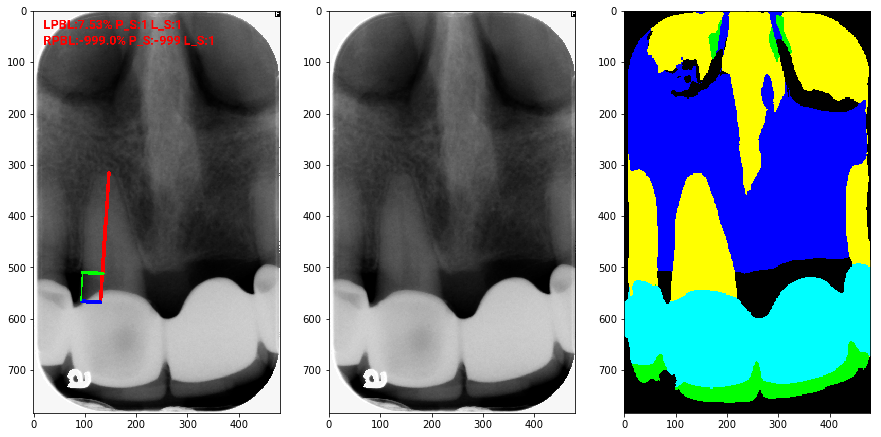

This case is human can not predict but model can.


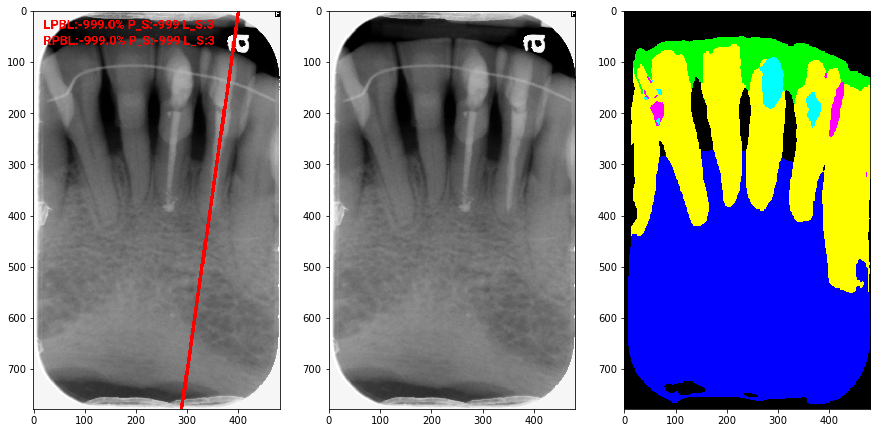

This case is human can not predict but model can.


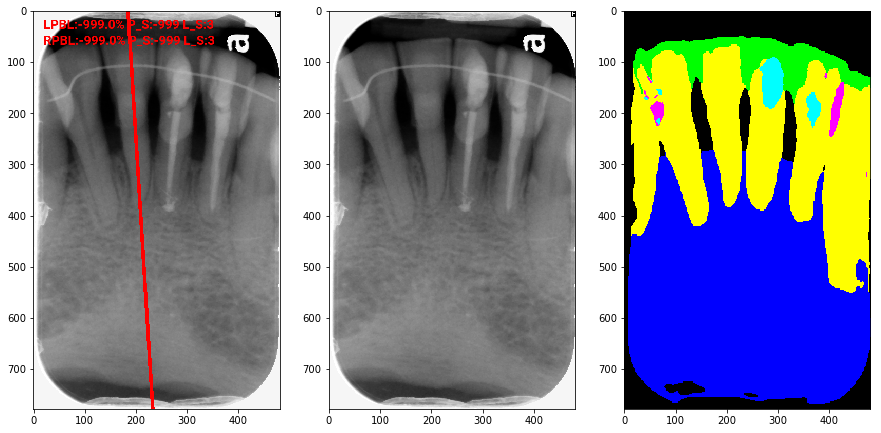

This case is human can not predict but model can.


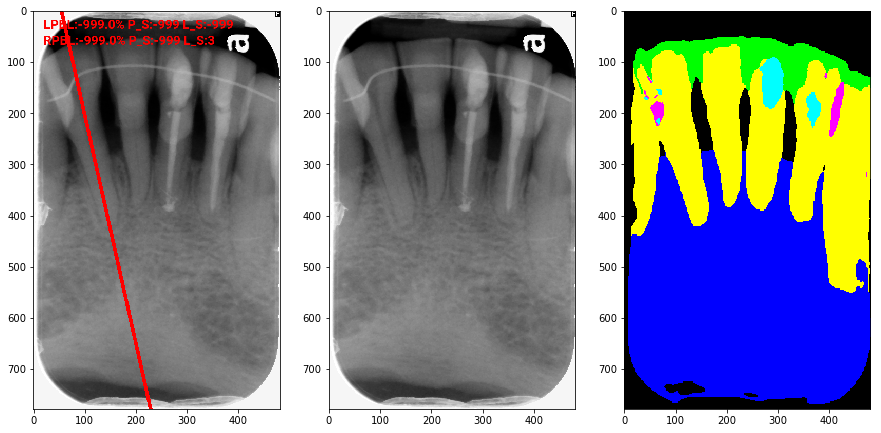

This case is human can not predict but model can.


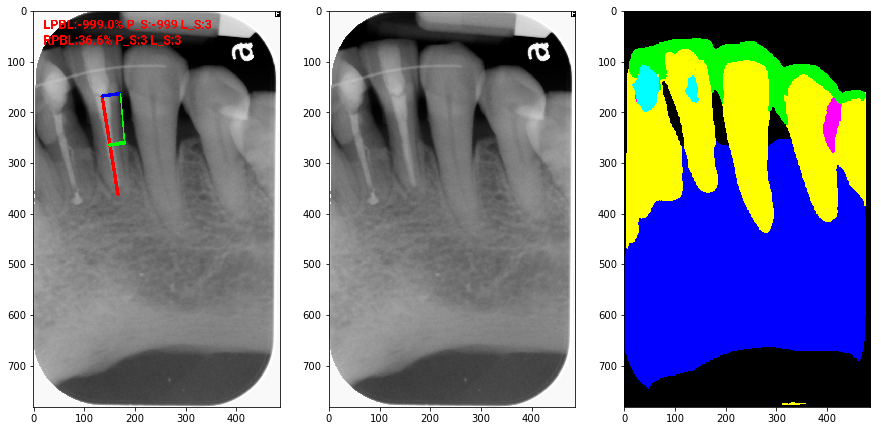

This case is human can not predict but model can.


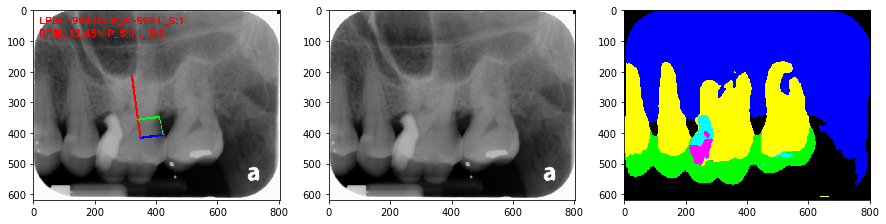

This case is human can not predict but model can.


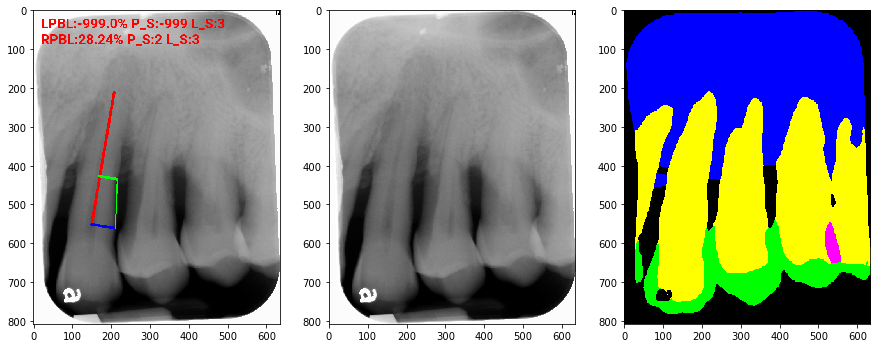

This case is human can not predict but model can.


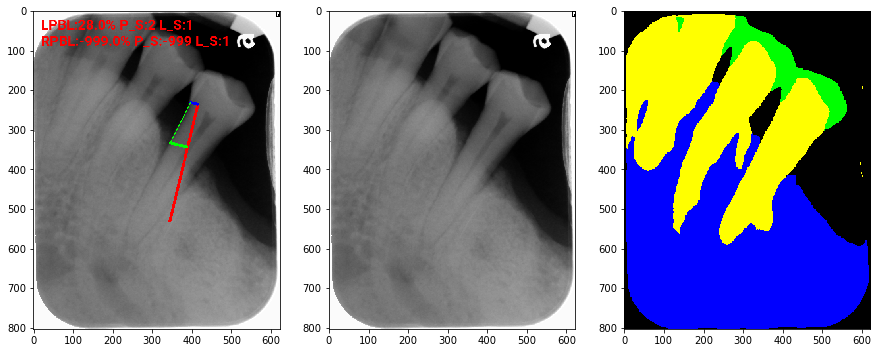

This case is human can not predict but model can.


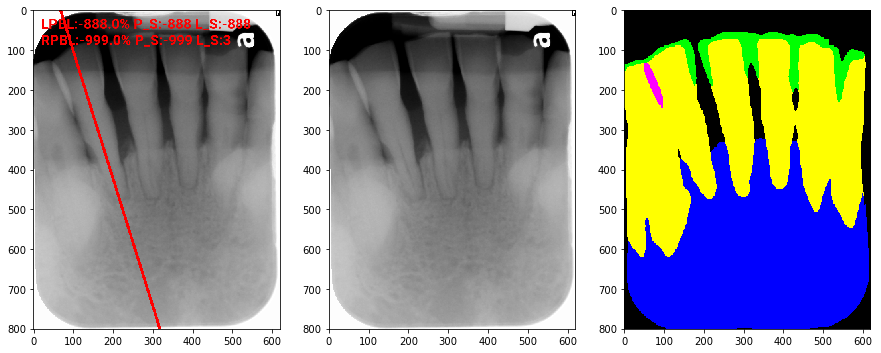

This case is human can not predict but model can.


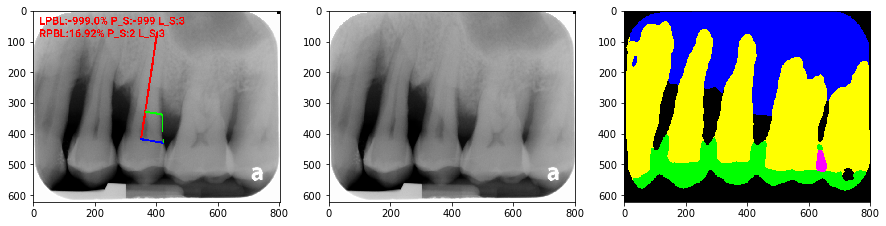

This case is human can not predict but model can.


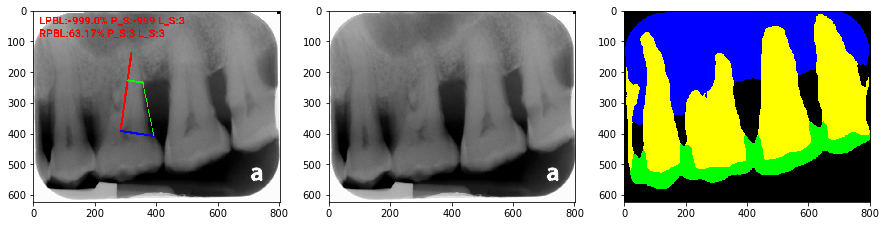

In [10]:
#Show the difference between the prediction and the doctor's judgment
o_img_folder = os.path.join(parent_folder_path,'1_o_image')
seg_img_folder = os.path.join(parent_folder_path,'1_seg_image')
path = os.path.join(parent_folder_path,'6_result_with_label')
image_path_list = glob.glob(path+'/*.PNG')
image_path_list.sort()

print(len(image_path_list))
count = 0
for index,image_path in tqdm(enumerate(image_path_list),total=len(image_path_list)):
    image_name = get_name_from_path(image_path,False)
    
    if image_name[-1] == '1':
        o_image_name = image_name[:-7]
        print('This case is human can not predict but model can.')
        o_image_path = os.path.join(o_img_folder,o_image_name+'.PNG')
        seg_image_path = os.path.join(seg_img_folder,o_image_name+'.PNG')
        plt.figure(figsize=(15,15))
        plt.subplot(131)
        plt.imshow(cv2.cvtColor(cv2.imread(image_path), cv2.COLOR_BGR2RGB))
        plt.subplot(132)
        plt.imshow(cv2.imread(o_image_path,0),cmap='gray')
        plt.subplot(133)
        plt.imshow(cv2.cvtColor(cv2.imread(seg_image_path), cv2.COLOR_BGR2RGB))
        plt.show()
        count +=1
    else:
        pass

In [11]:
count = 50
print(count)

50


473


This case is human can predict but model can not.


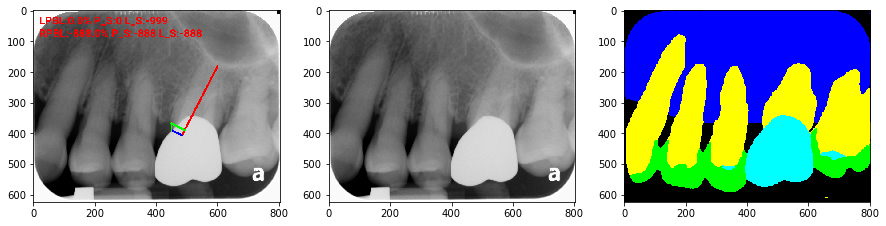

This case is human can predict but model can not.


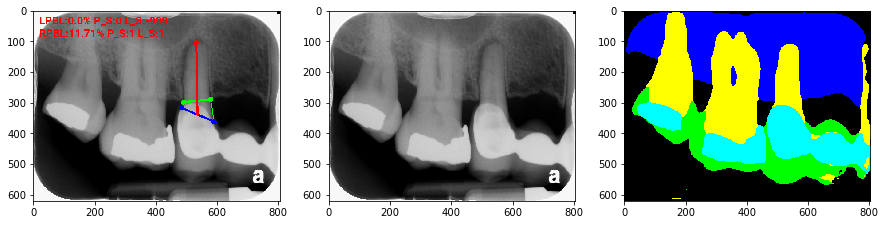

This case is human can predict but model can not.


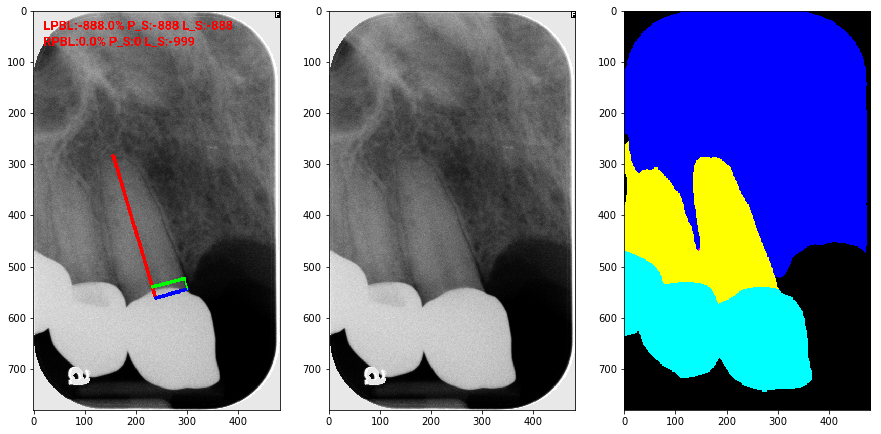

This case is human can predict but model can not.


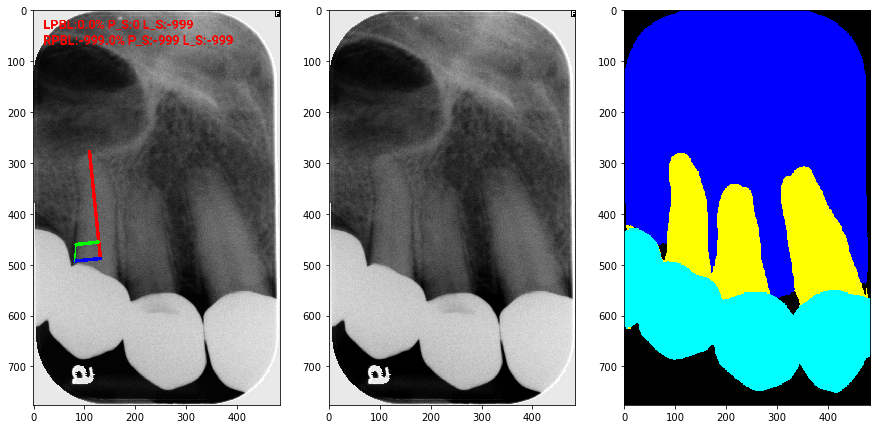

This case is human can predict but model can not.


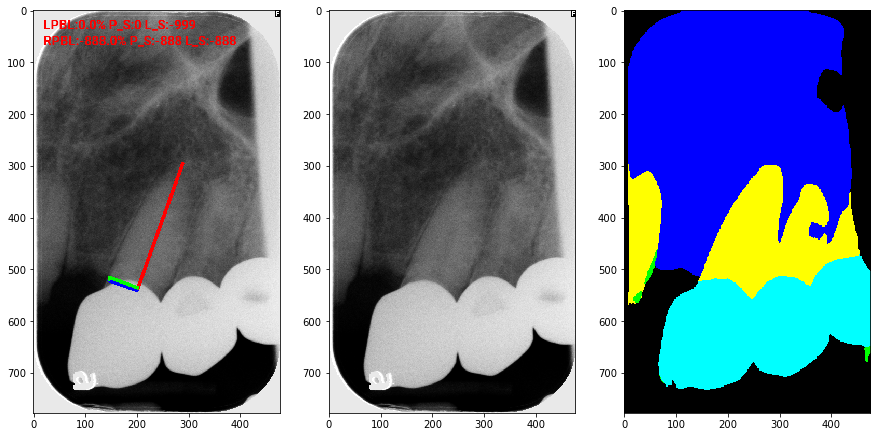

This case is human can predict but model can not.


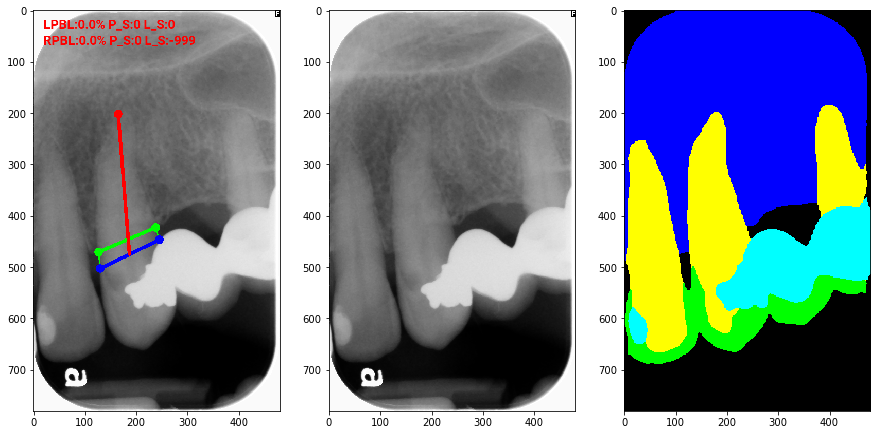

This case is human can predict but model can not.


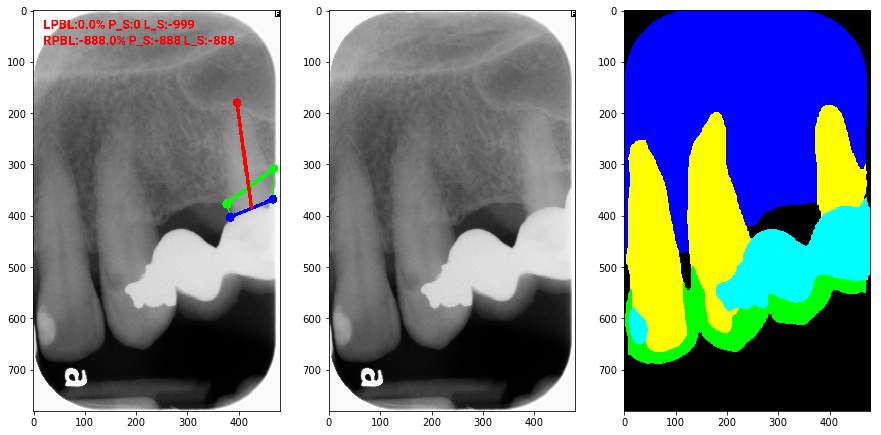

This case is human can predict but model can not.


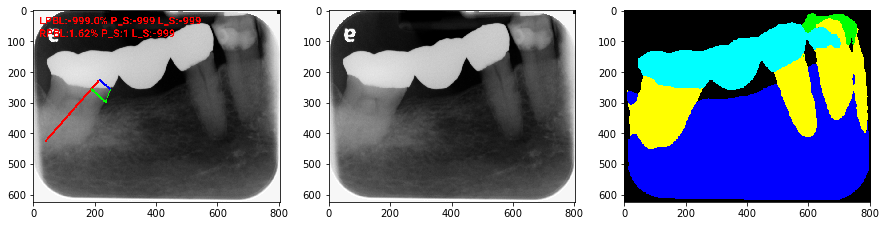

This case is human can predict but model can not.


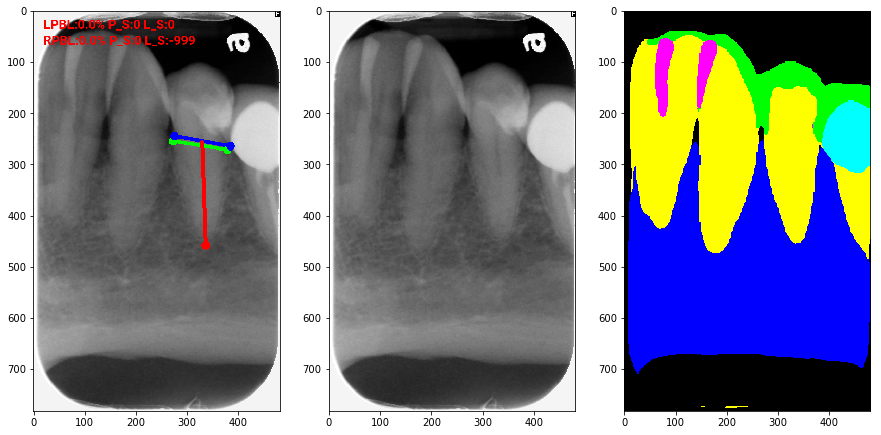

This case is human can predict but model can not.


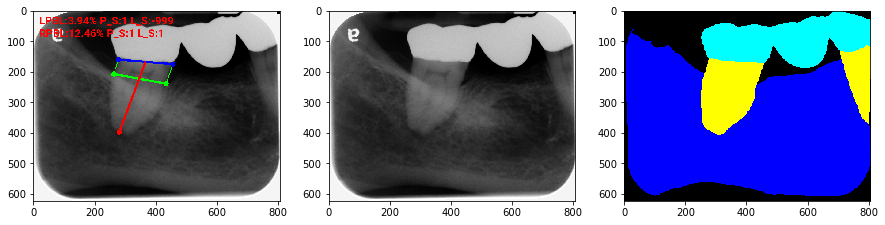

This case is human can predict but model can not.


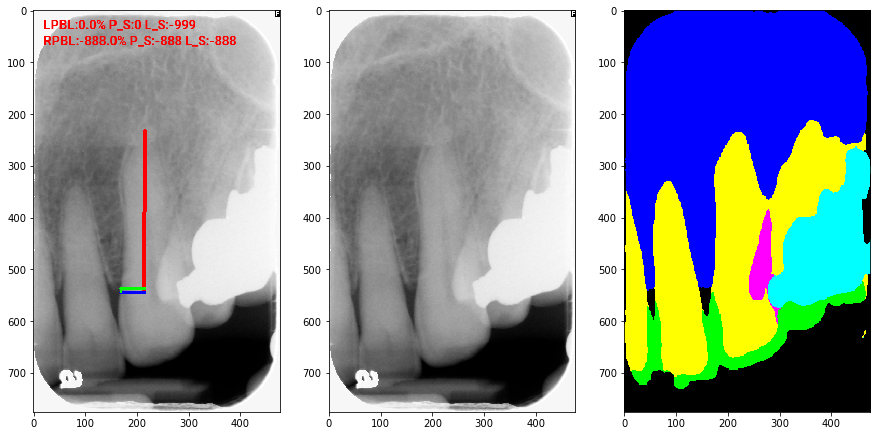

This case is human can predict but model can not.


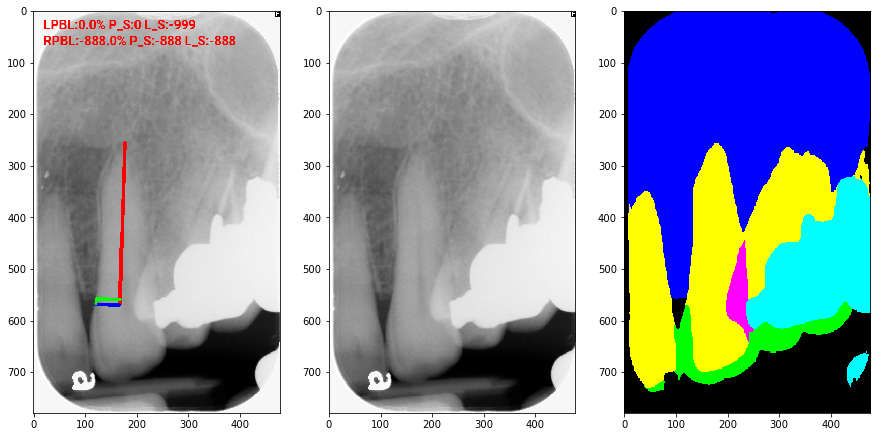

This case is human can predict but model can not.


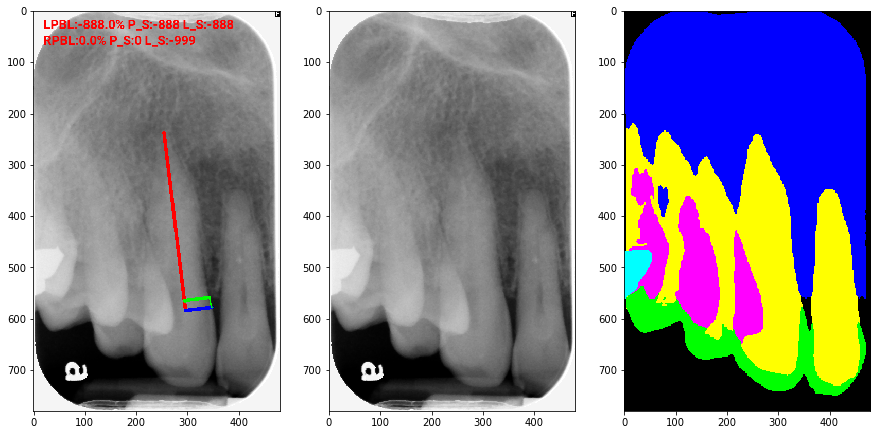

This case is human can predict but model can not.


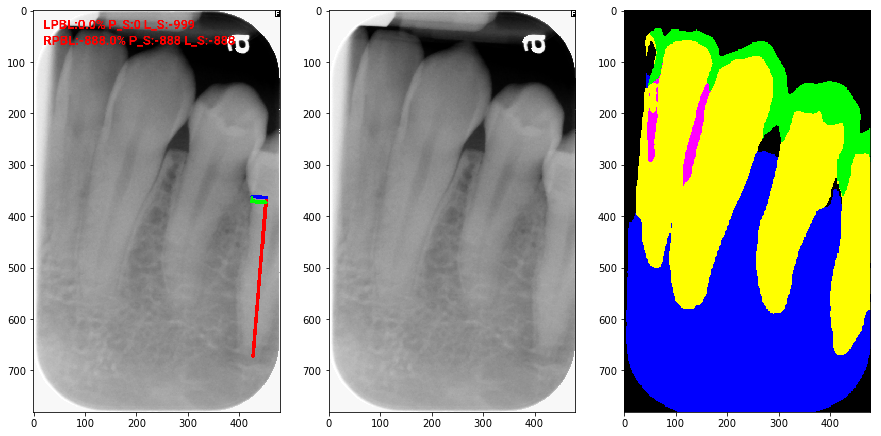

This case is human can predict but model can not.


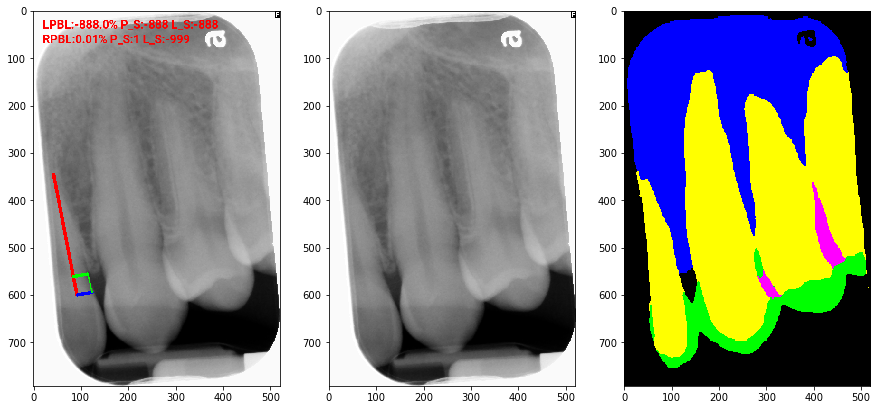

This case is human can predict but model can not.


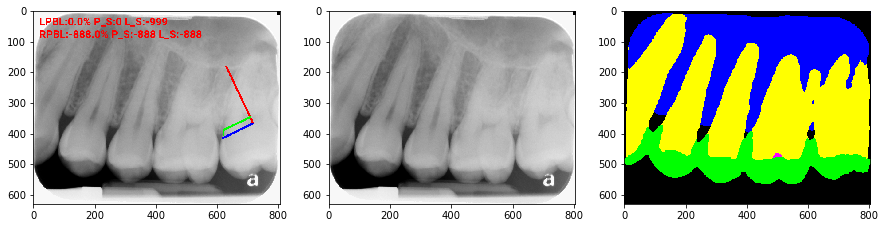

This case is human can predict but model can not.


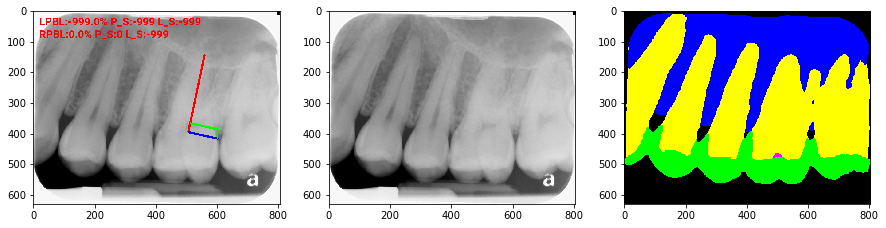

This case is human can predict but model can not.


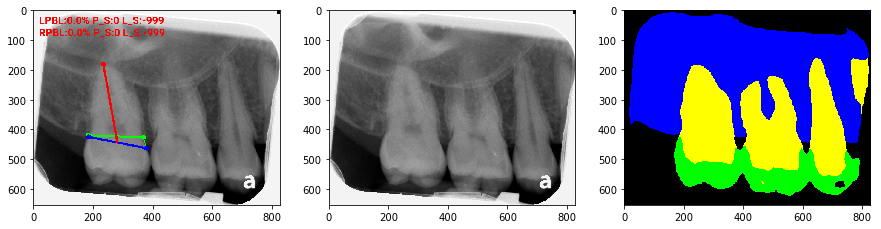

This case is human can predict but model can not.


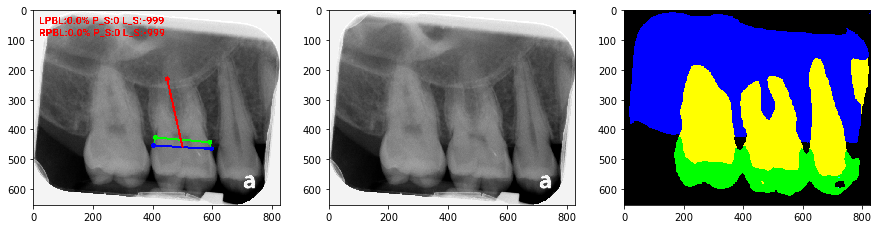

This case is human can predict but model can not.


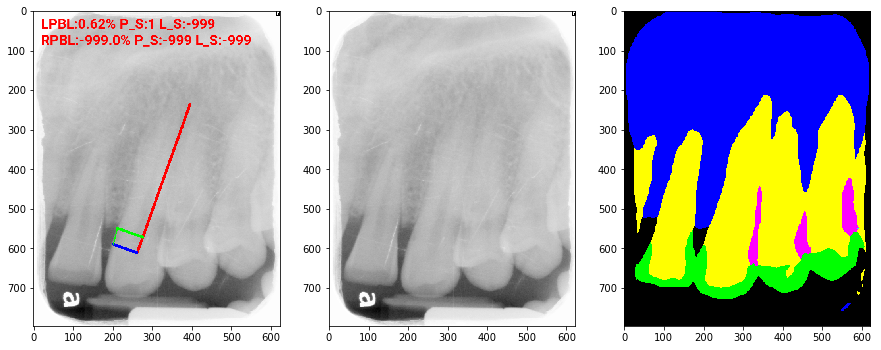

This case is human can predict but model can not.


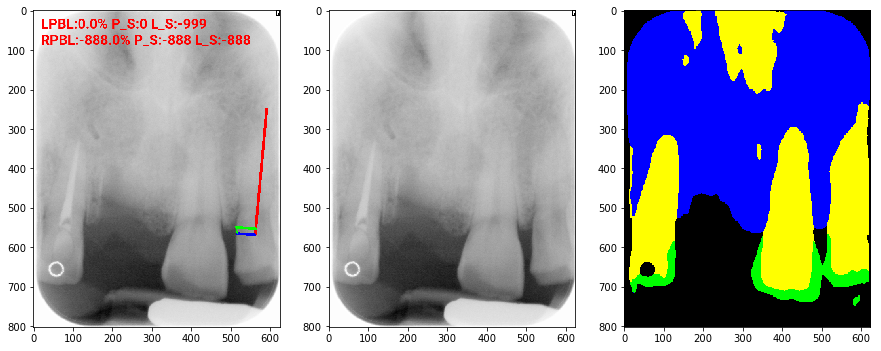

This case is human can predict but model can not.


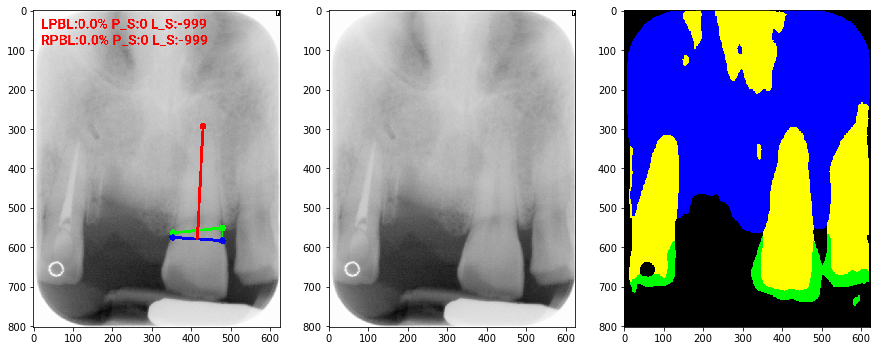

This case is human can predict but model can not.


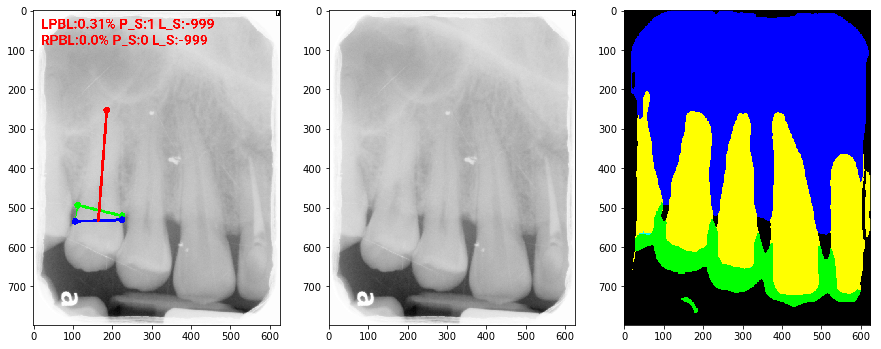

This case is human can predict but model can not.


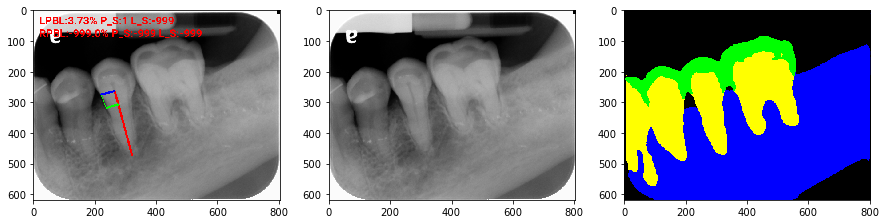

This case is human can predict but model can not.


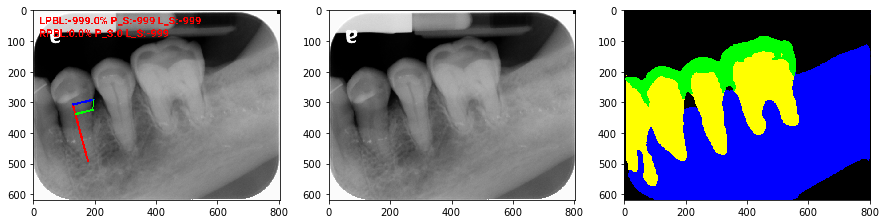

This case is human can predict but model can not.


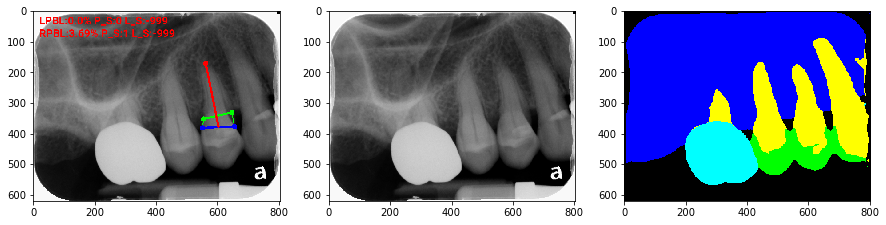

This case is human can predict but model can not.


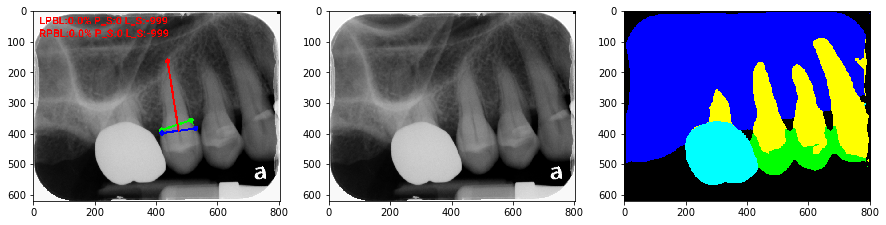

This case is human can predict but model can not.


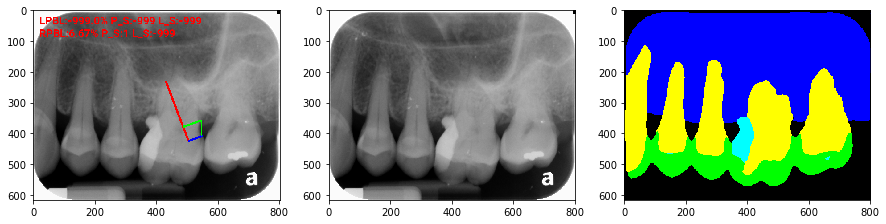

This case is human can predict but model can not.


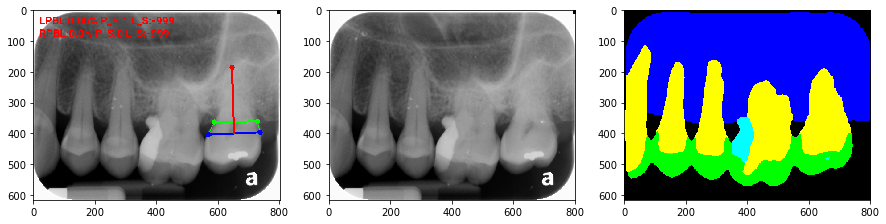

This case is human can predict but model can not.


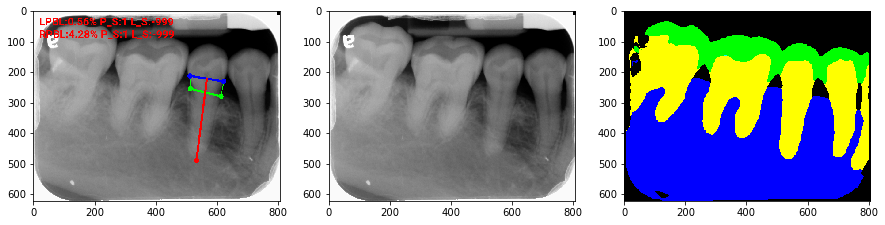

This case is human can predict but model can not.


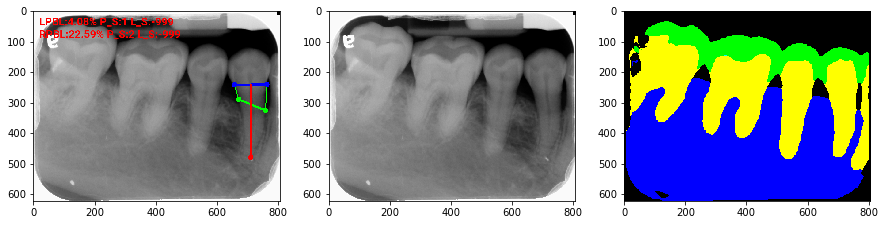

This case is human can predict but model can not.


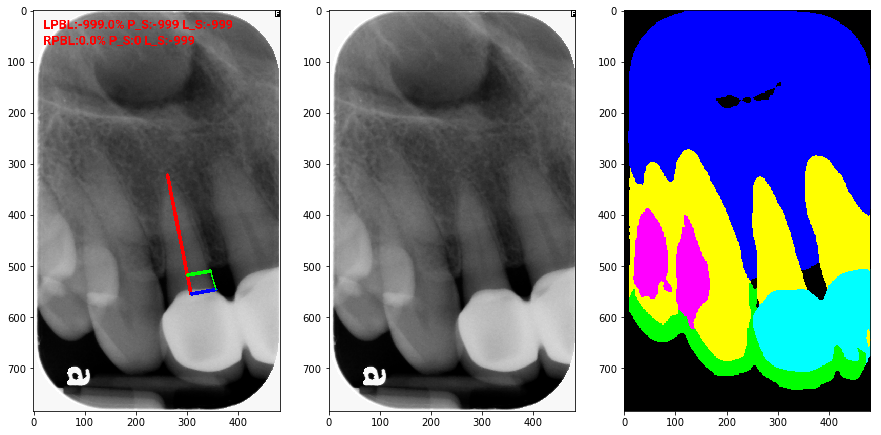

This case is human can predict but model can not.


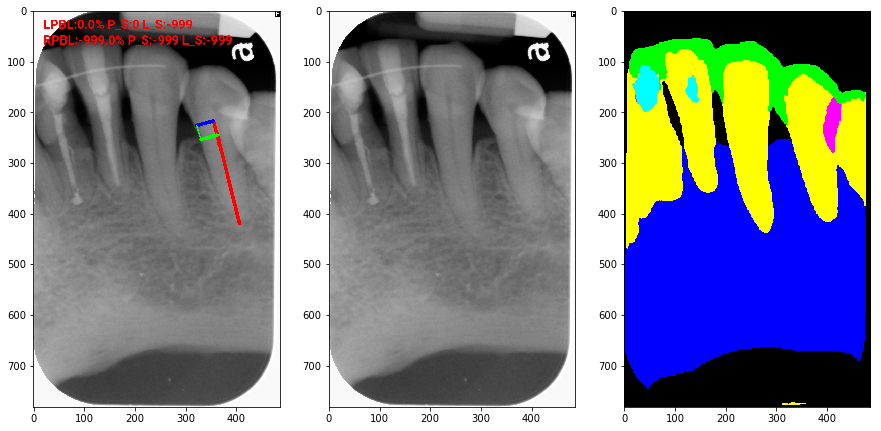

This case is human can predict but model can not.


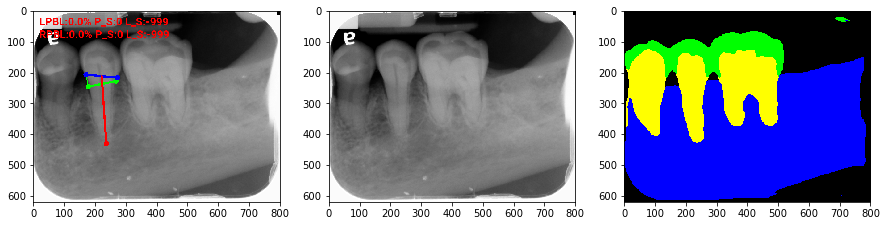

This case is human can predict but model can not.


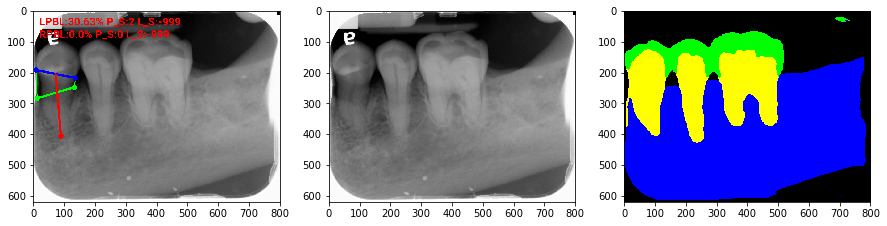

This case is human can predict but model can not.


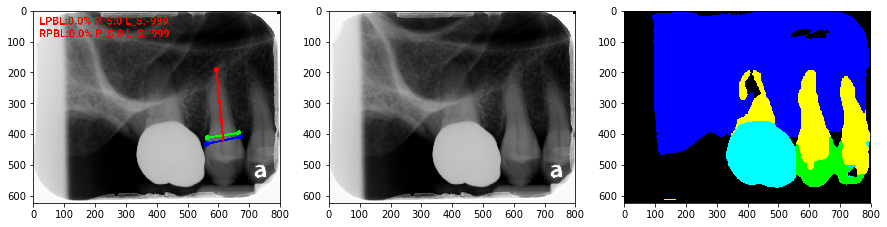

This case is human can predict but model can not.


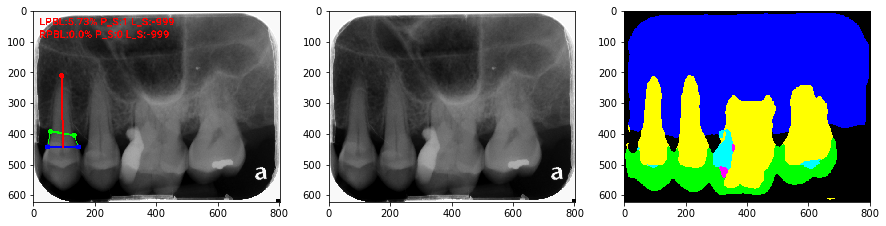

This case is human can predict but model can not.


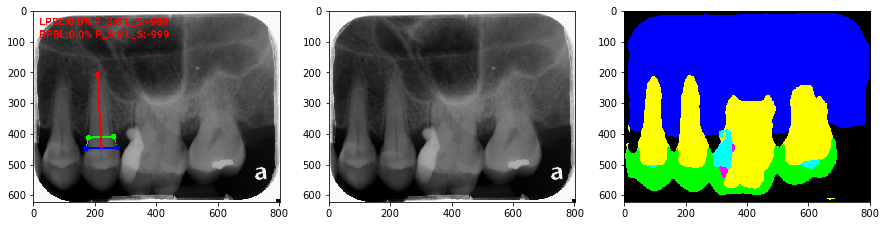

This case is human can predict but model can not.


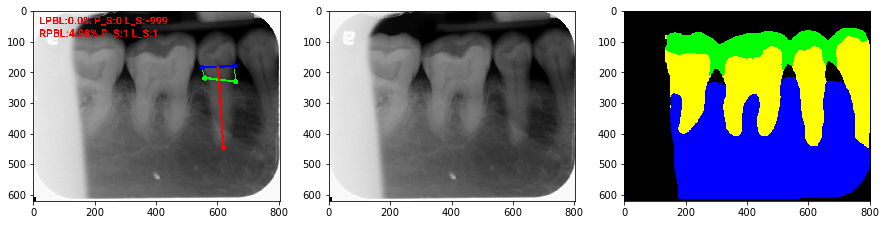

This case is human can predict but model can not.


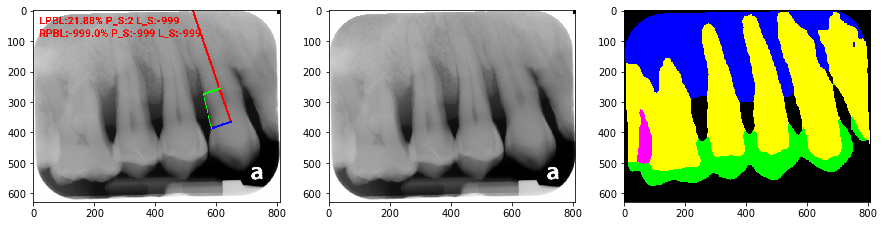

This case is human can predict but model can not.


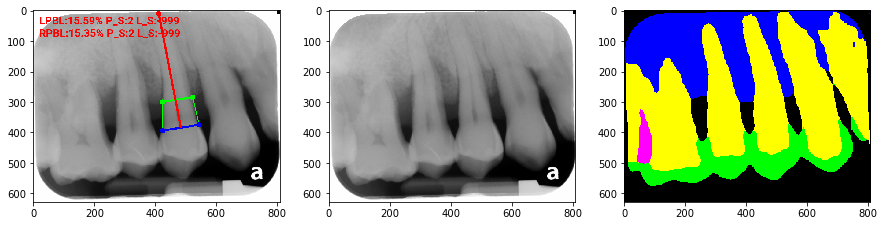

This case is human can predict but model can not.


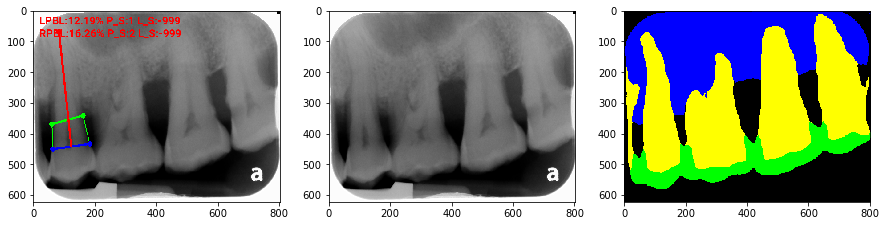

In [12]:
#Show the difference between the prediction and the doctor's judgment
o_img_folder = os.path.join(parent_folder_path,'1_o_image')
seg_img_folder = os.path.join(parent_folder_path,'1_seg_image')
path = os.path.join(parent_folder_path,'6_result_with_label')
image_path_list = glob.glob(path+'/*.PNG')
image_path_list.sort()

print(len(image_path_list))
count = 0
for index,image_path in tqdm(enumerate(image_path_list),total=len(image_path_list)):
    image_name = get_name_from_path(image_path,False)
    
    if image_name[-1] == '2':
        o_image_name = image_name[:-7]
        print('This case is human can predict but model can not.')
        o_image_path = os.path.join(o_img_folder,o_image_name+'.PNG')
        seg_image_path = os.path.join(seg_img_folder,o_image_name+'.PNG')
        plt.figure(figsize=(15,15))
        plt.subplot(131)
        plt.imshow(cv2.cvtColor(cv2.imread(image_path), cv2.COLOR_BGR2RGB))
        plt.subplot(132)
        plt.imshow(cv2.imread(o_image_path,0),cmap='gray')
        plt.subplot(133)
        plt.imshow(cv2.cvtColor(cv2.imread(seg_image_path), cv2.COLOR_BGR2RGB))
        plt.show()
        count +=1
    else:
        pass

In [13]:
count = 43
print(count)

43


In [14]:
# img = cv2.imread('/root/notebooks/tooth_project/tooth_PBL_detection/Pattern_detection/roots_point_detect/6_result_with_label/NN_130821_101512_C057C4_1_err12.PNG')
# img.shape
# plt.imshow(img)

473


This case is tooth did not match.


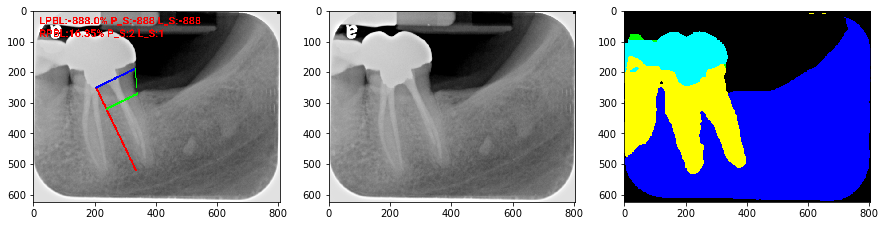

This case is tooth did not match.


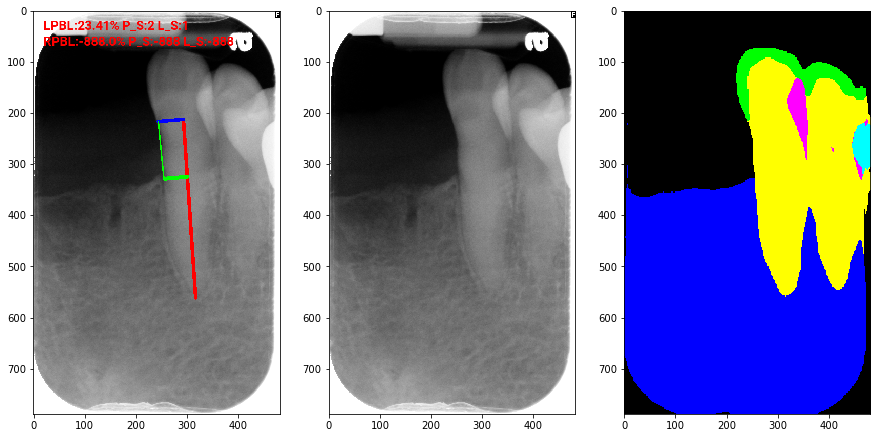

This case is tooth did not match.


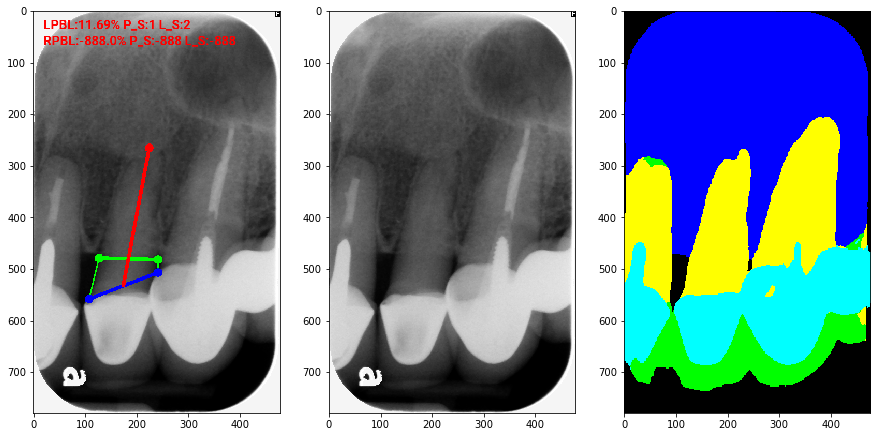

This case is tooth did not match.


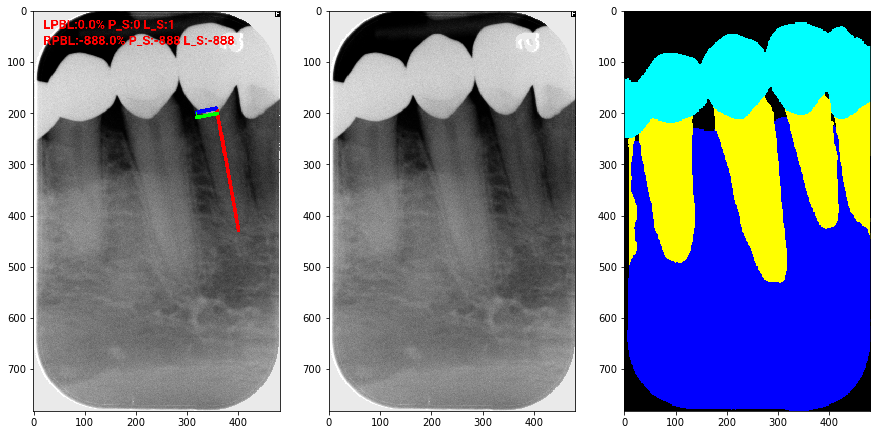

This case is tooth did not match.


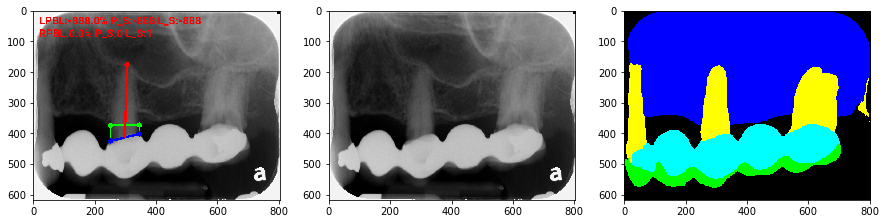

This case is tooth did not match.


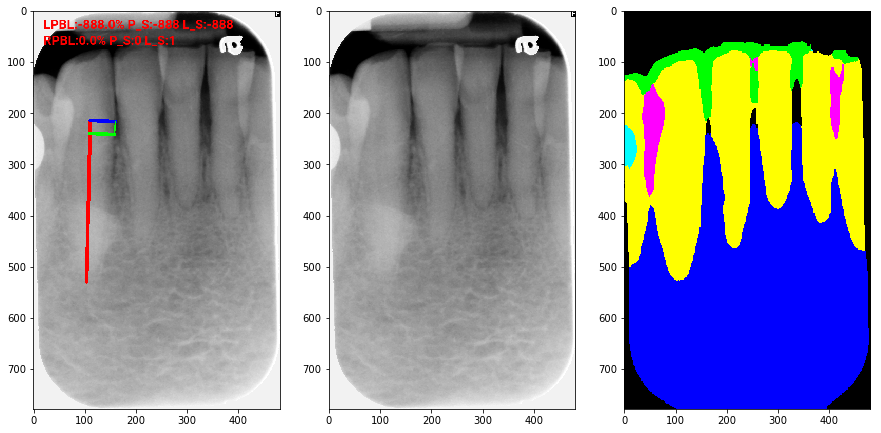

This case is tooth did not match.


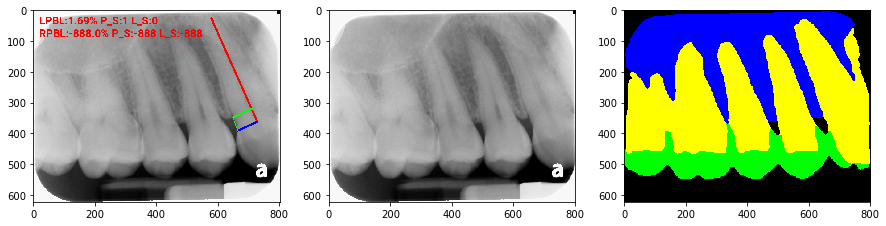

This case is tooth did not match.


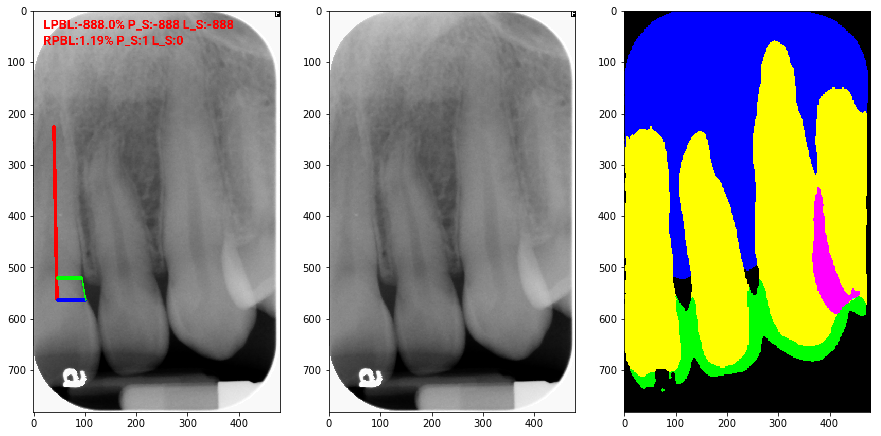

This case is tooth did not match.


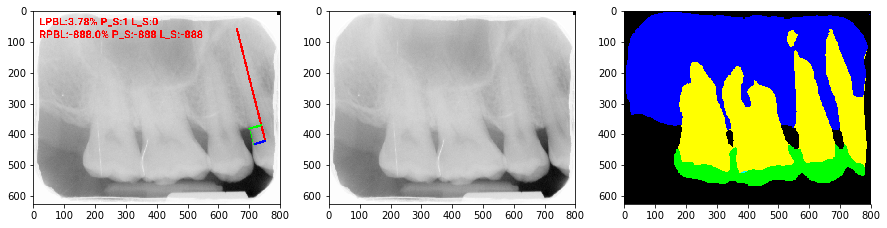

This case is tooth did not match.


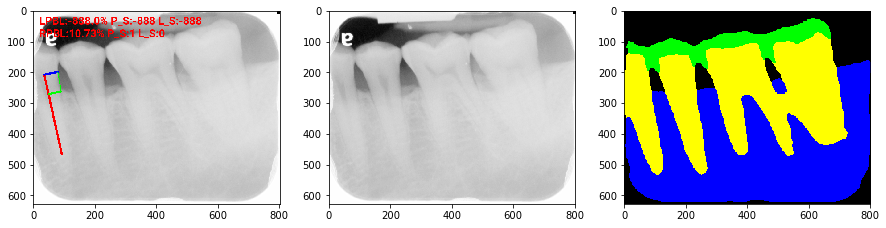

This case is tooth did not match.


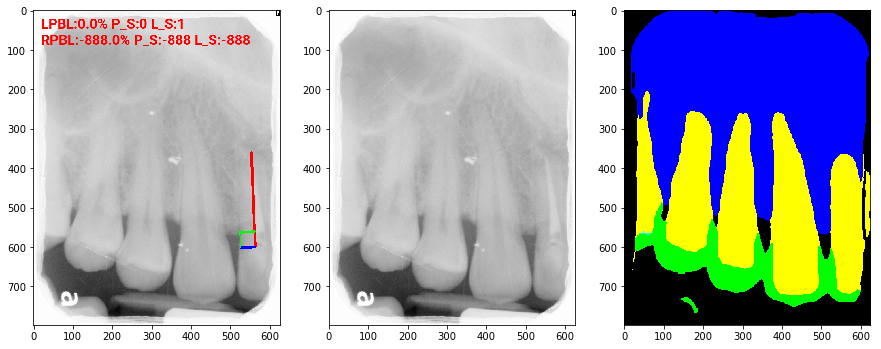

This case is tooth did not match.


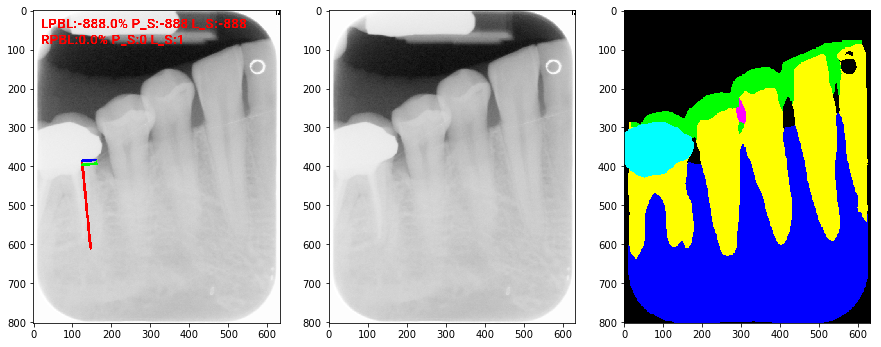

This case is tooth did not match.


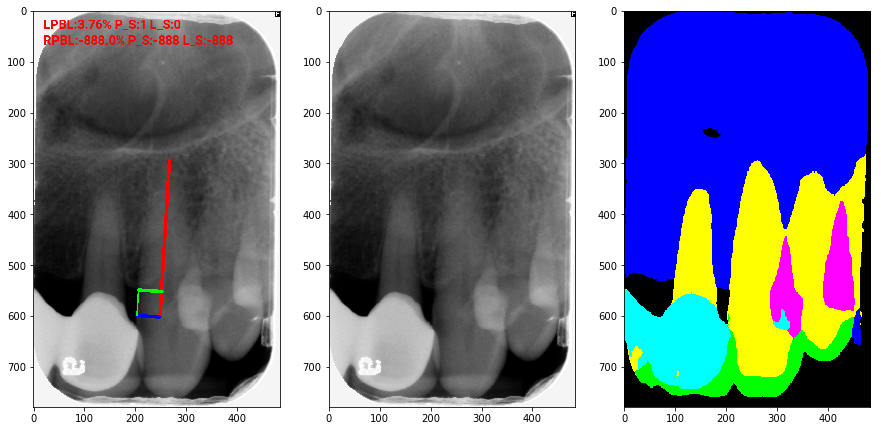

In [15]:
#Show the difference between the prediction and the doctor's judgment
o_img_folder = os.path.join(parent_folder_path,'1_o_image')
seg_img_folder = os.path.join(parent_folder_path,'1_seg_image')
path = os.path.join(parent_folder_path,'6_result_with_label')
image_path_list = glob.glob(path+'/*.PNG')
image_path_list.sort()

print(len(image_path_list))
count = 0
for index,image_path in tqdm(enumerate(image_path_list),total=len(image_path_list)):
    image_name = get_name_from_path(image_path,False)
    
    if image_name[-1] == '3':
        o_image_name = image_name[:-7]
        print('This case is tooth did not match.')
        o_image_path = os.path.join(o_img_folder,o_image_name+'.PNG')
        seg_image_path = os.path.join(seg_img_folder,o_image_name+'.PNG')
        plt.figure(figsize=(15,15))
        plt.subplot(131)
        plt.imshow(cv2.cvtColor(cv2.imread(image_path), cv2.COLOR_BGR2RGB))
        plt.subplot(132)
        plt.imshow(cv2.imread(o_image_path,0),cmap='gray')
        plt.subplot(133)
        plt.imshow(cv2.cvtColor(cv2.imread(seg_image_path), cv2.COLOR_BGR2RGB))
        plt.show()
        count +=1
    else:
        pass

In [16]:
count = 13
print(count)

13


473


Predict got different value


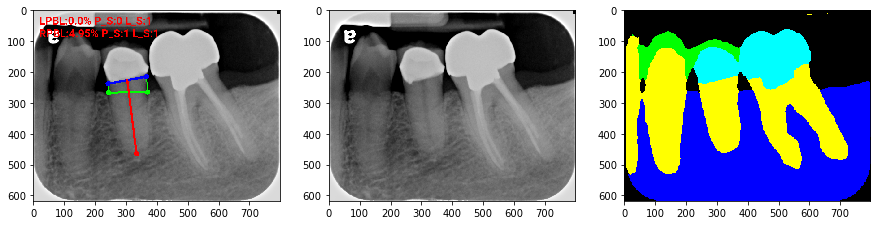

Predict got different value


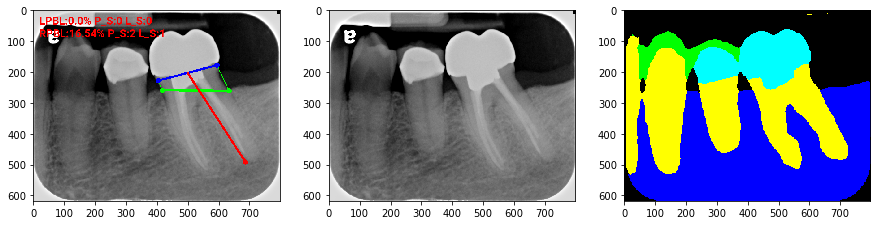

Predict got different value


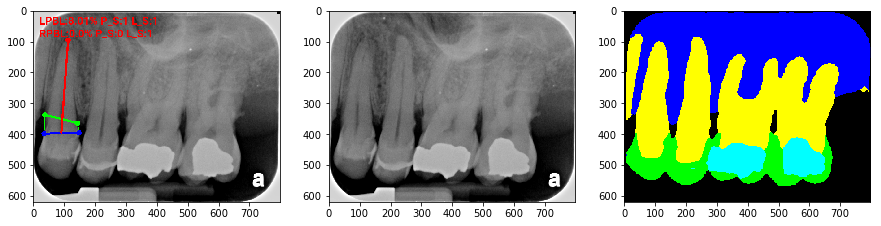

Predict got different value


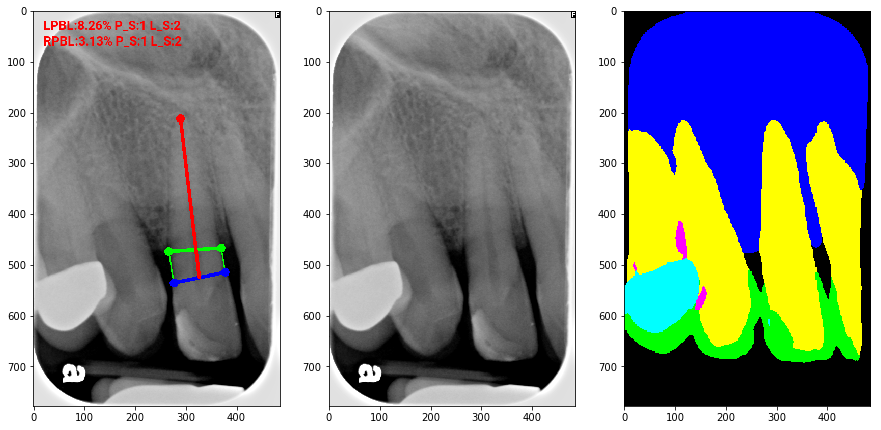

Predict got different value


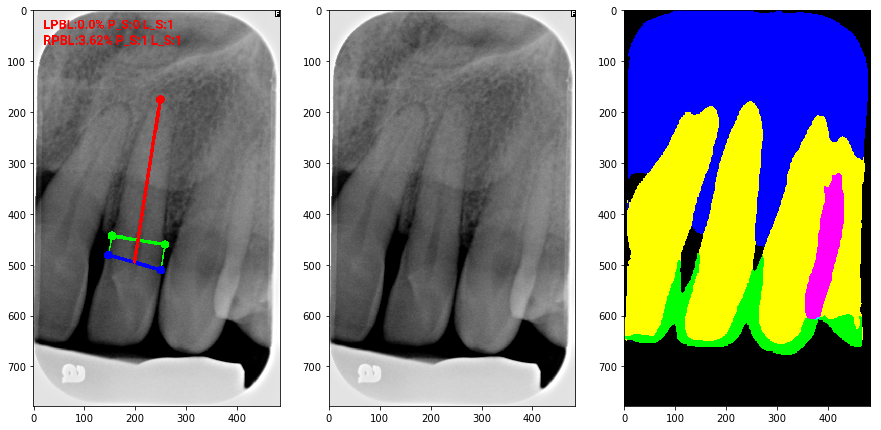

Predict got different value


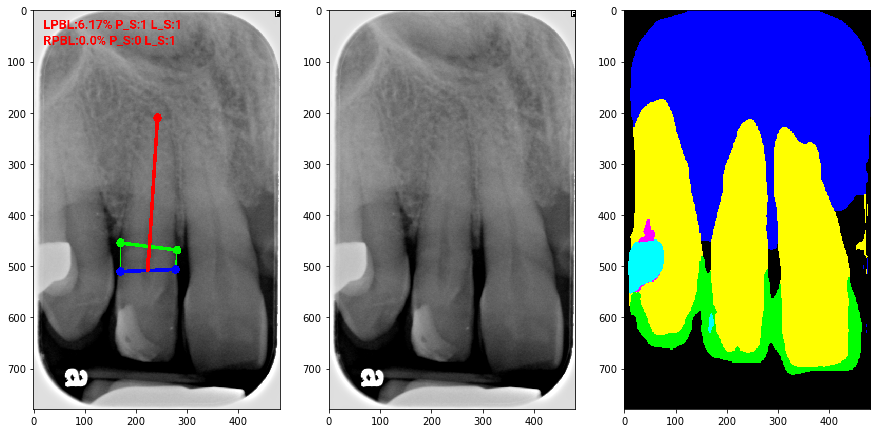

Predict got different value


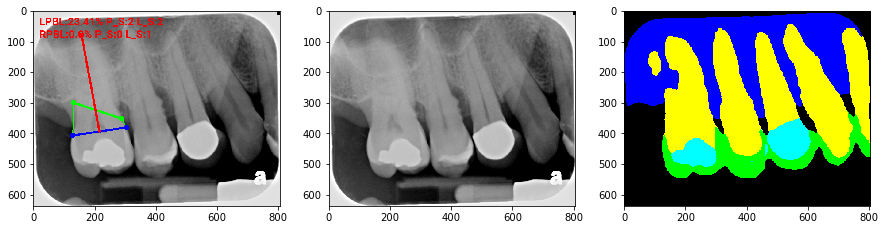

Predict got different value


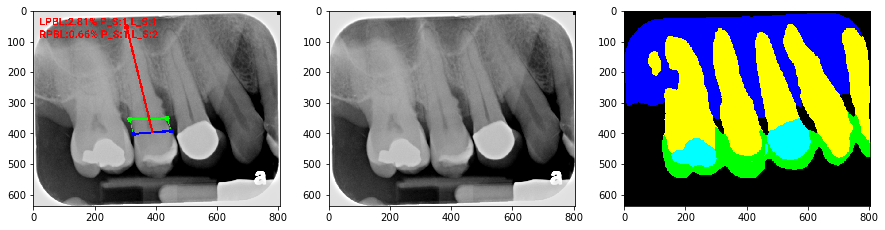

Predict got different value


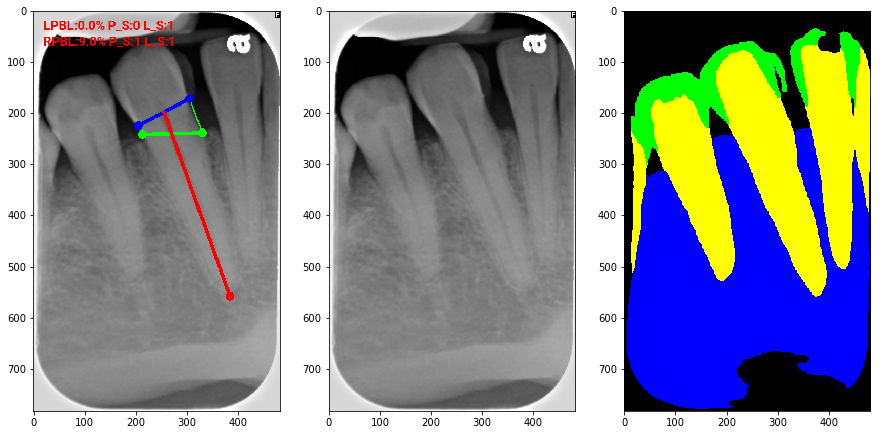

Predict got different value


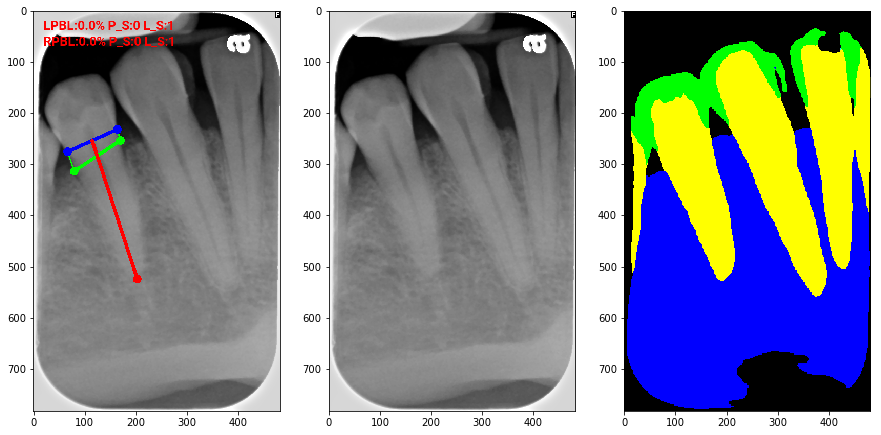

Predict got different value


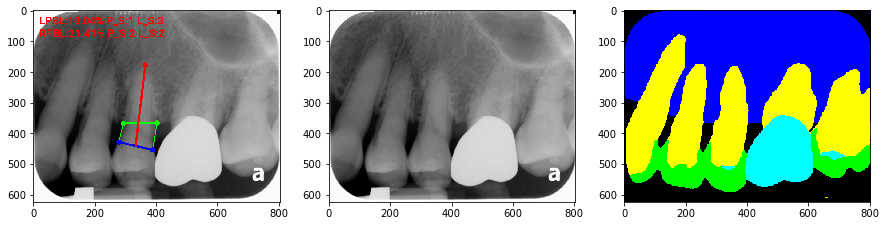

Predict got different value


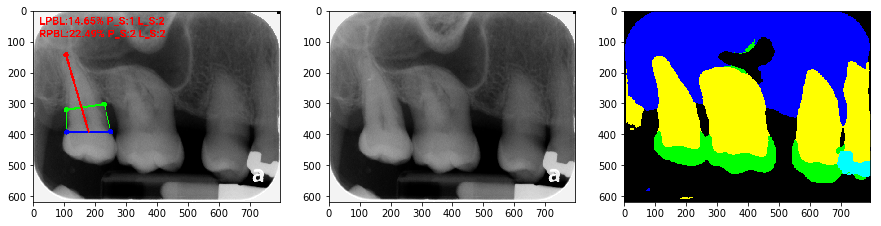

Predict got different value


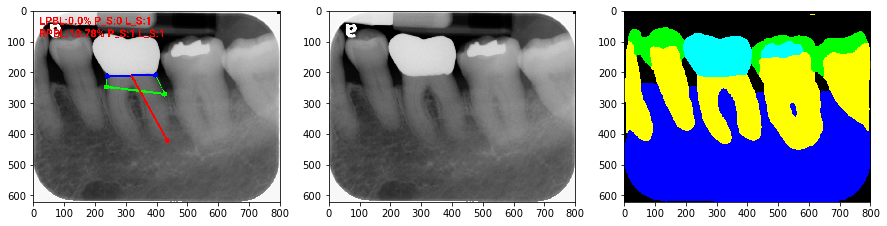

Predict got different value


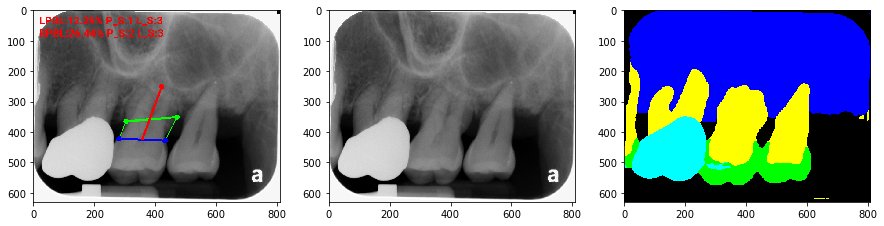

Predict got different value


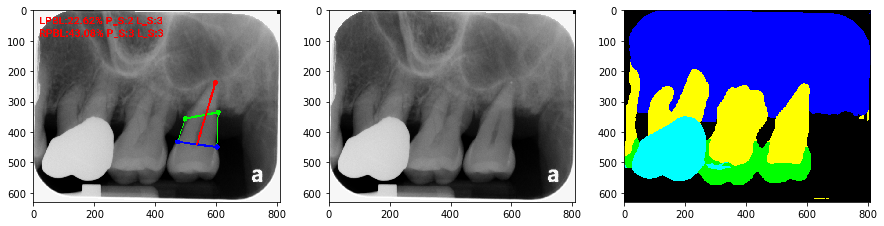

Predict got different value


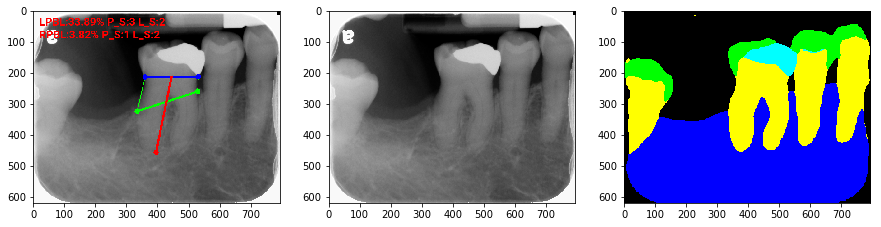

Predict got different value


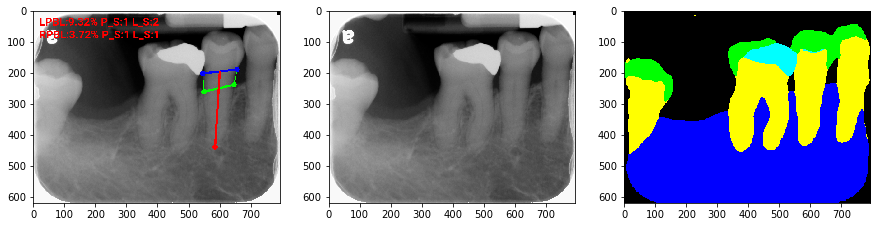

Predict got different value


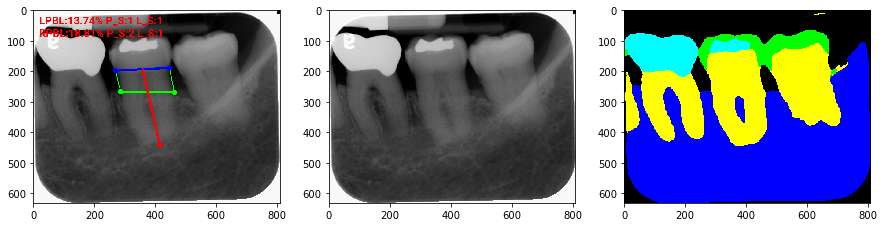

Predict got different value


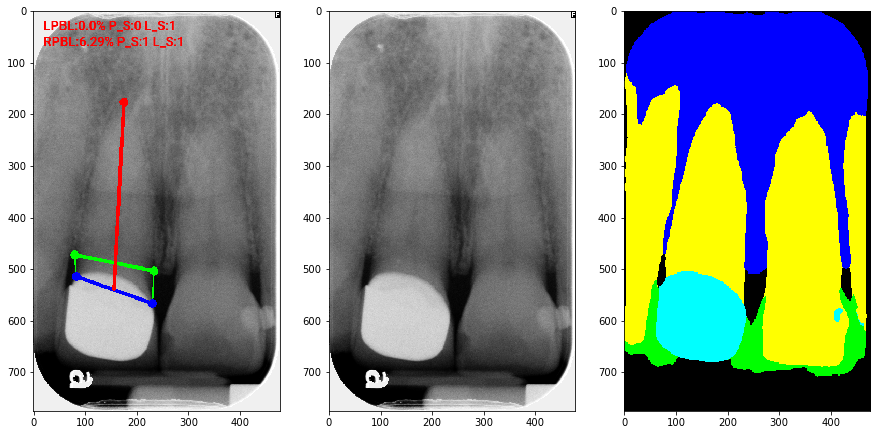

Predict got different value


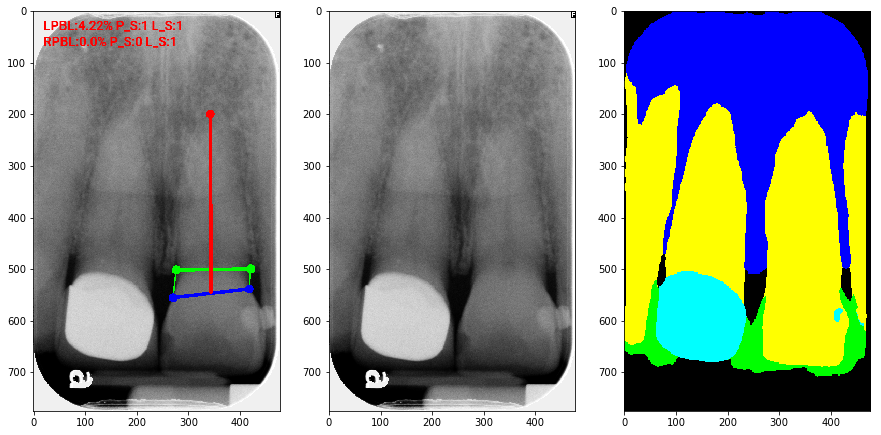

Predict got different value


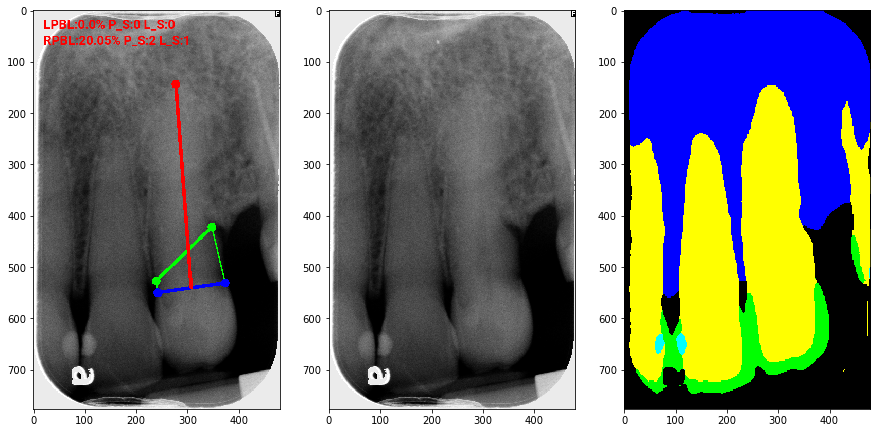

Predict got different value


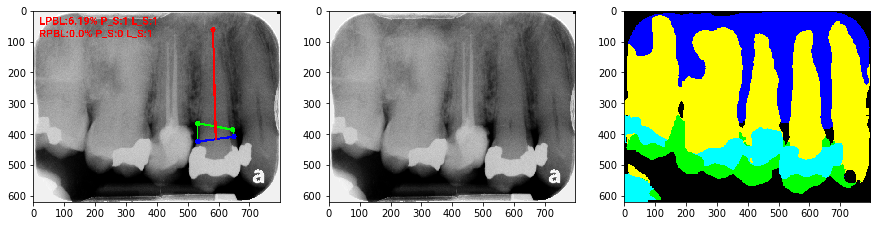

Predict got different value


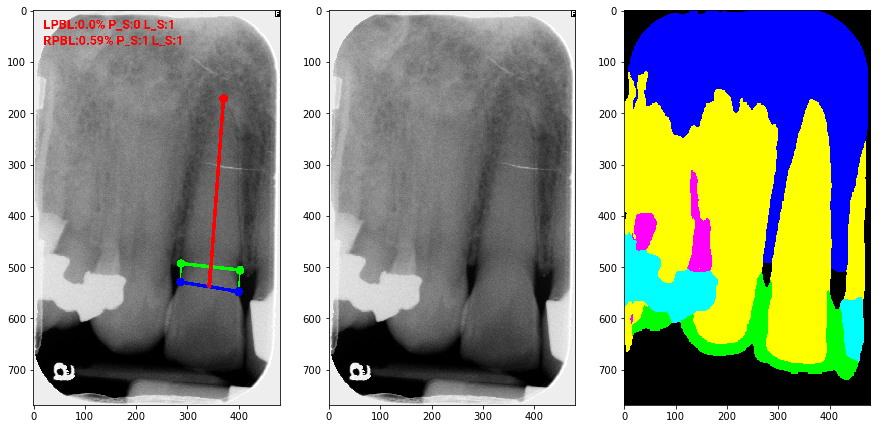

Predict got different value


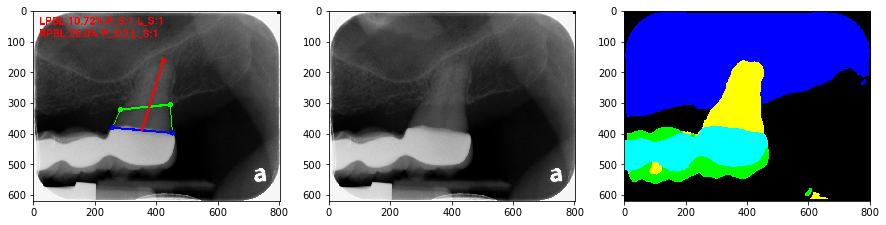

Predict got different value


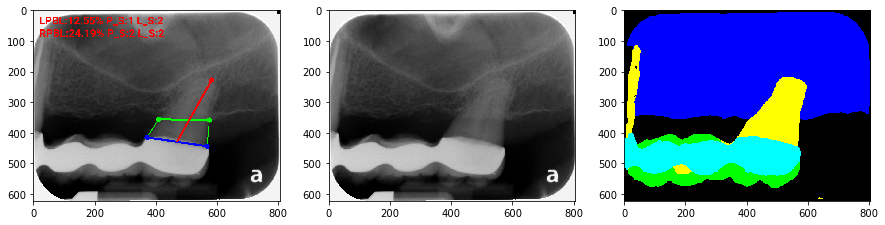

Predict got different value


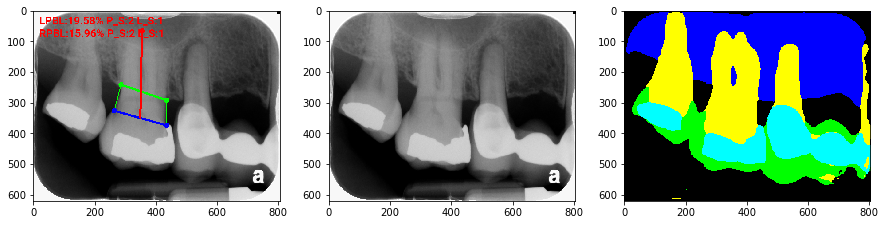

Predict got different value


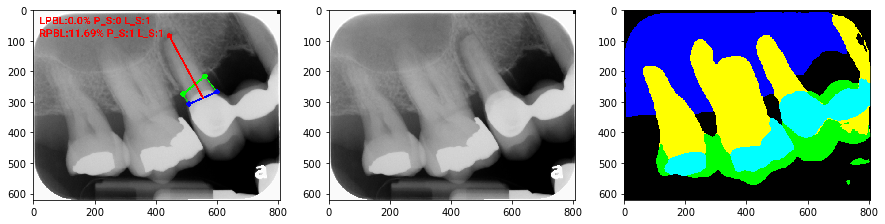

Predict got different value


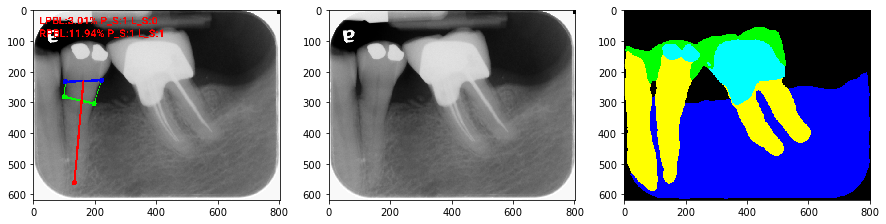

Predict got different value


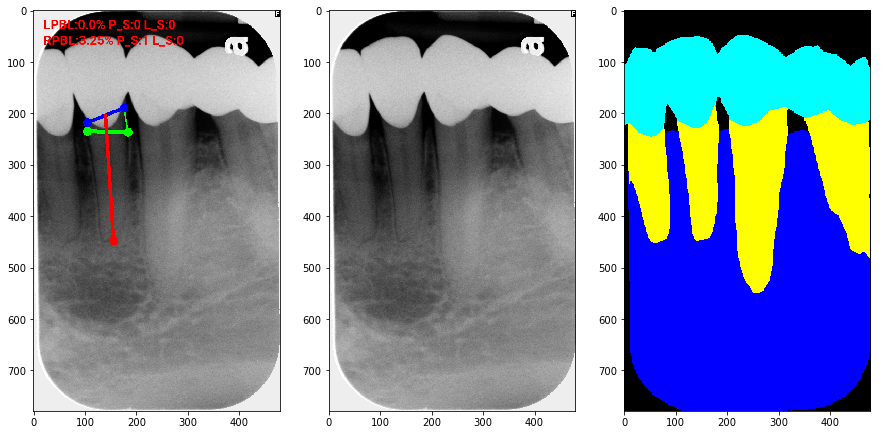

Predict got different value


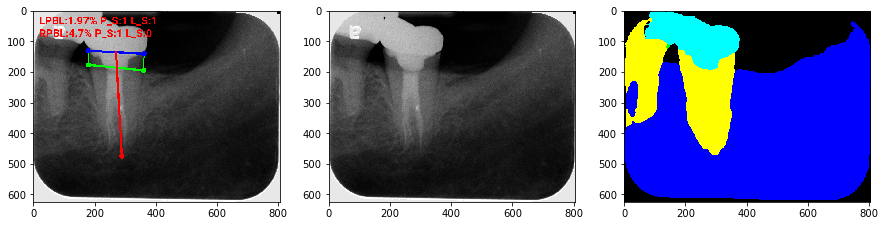

Predict got different value


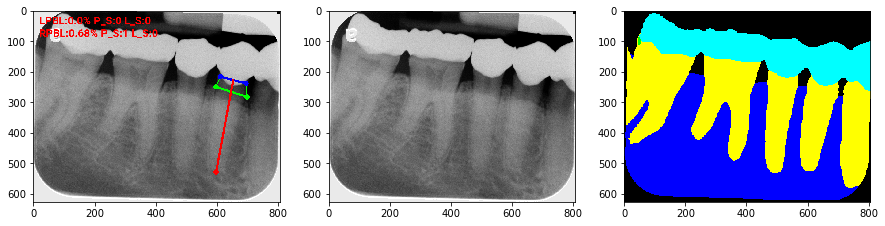

Predict got different value


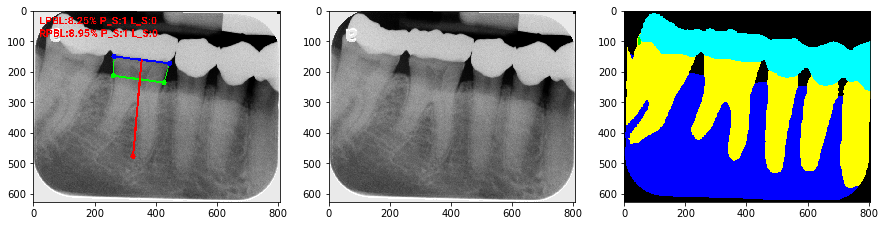

Predict got different value


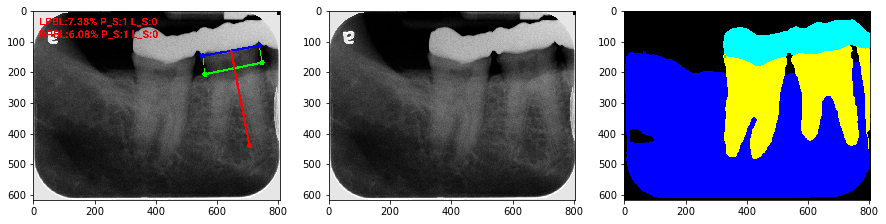

Predict got different value


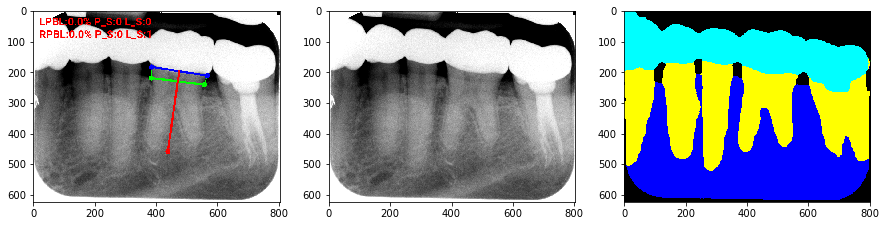

Predict got different value


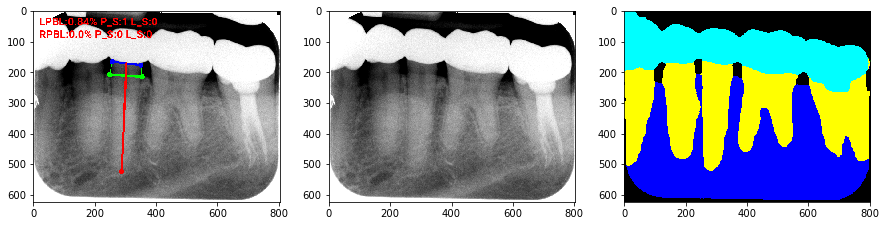

Predict got different value


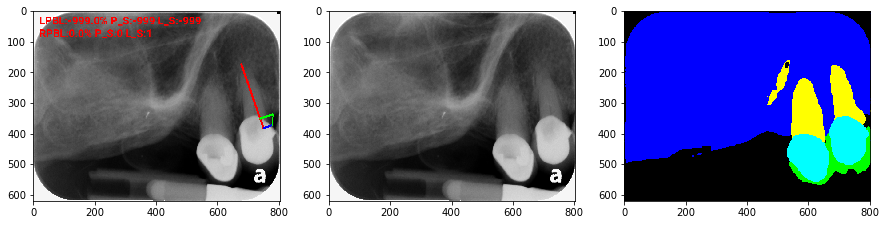

Predict got different value


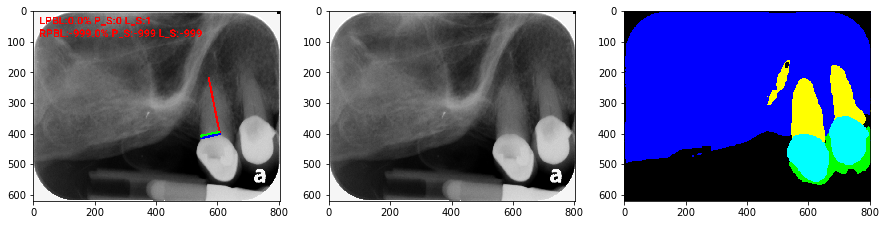

Predict got different value


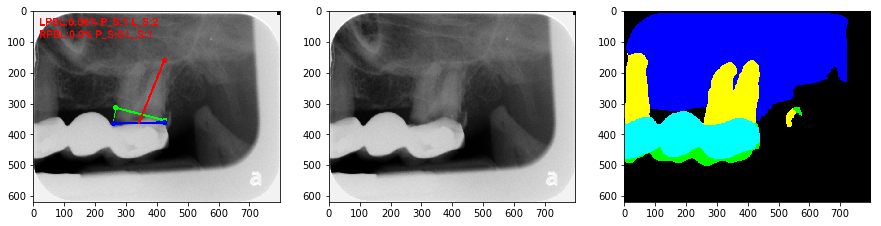

Predict got different value


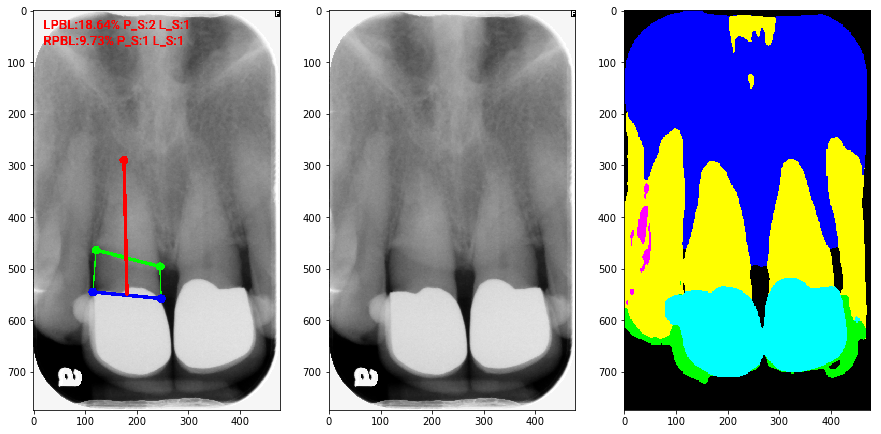

Predict got different value


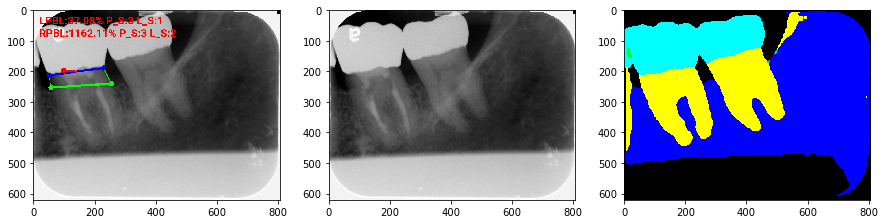

Predict got different value


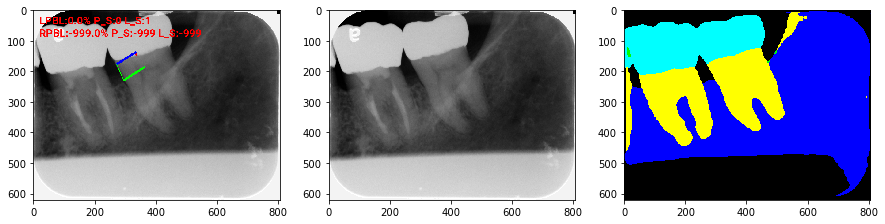

Predict got different value


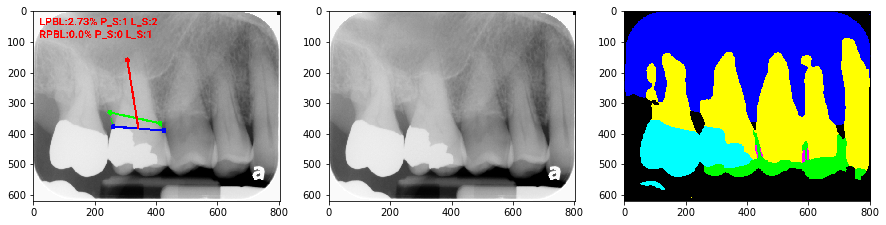

Predict got different value


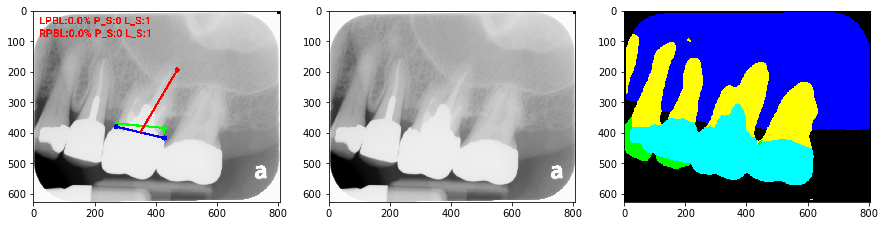

Predict got different value


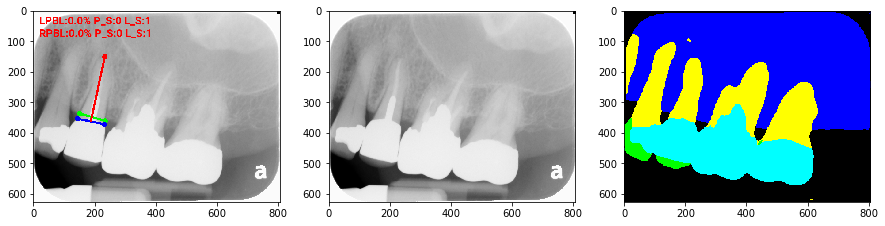

Predict got different value


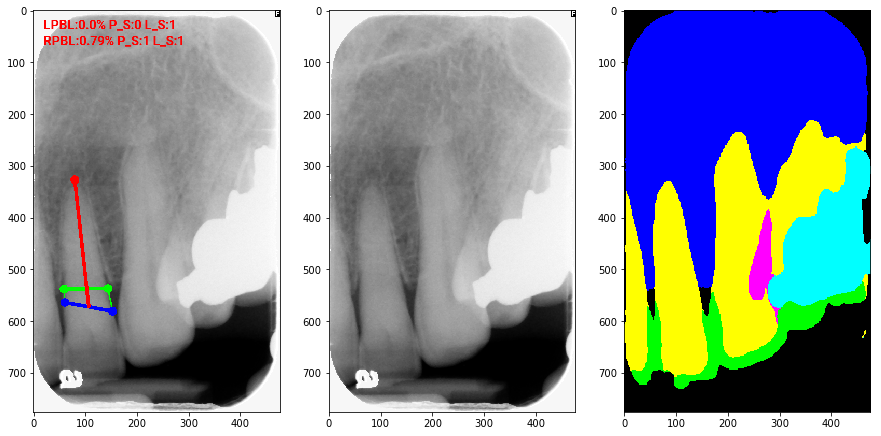

Predict got different value


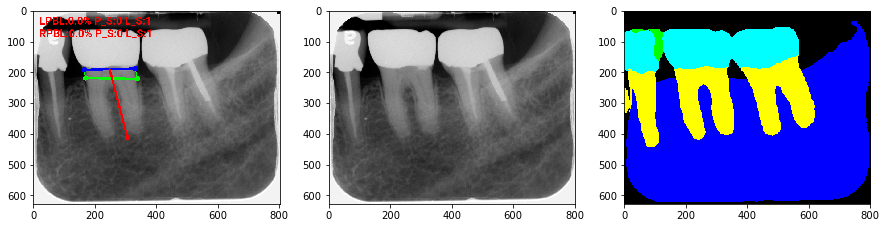

Predict got different value


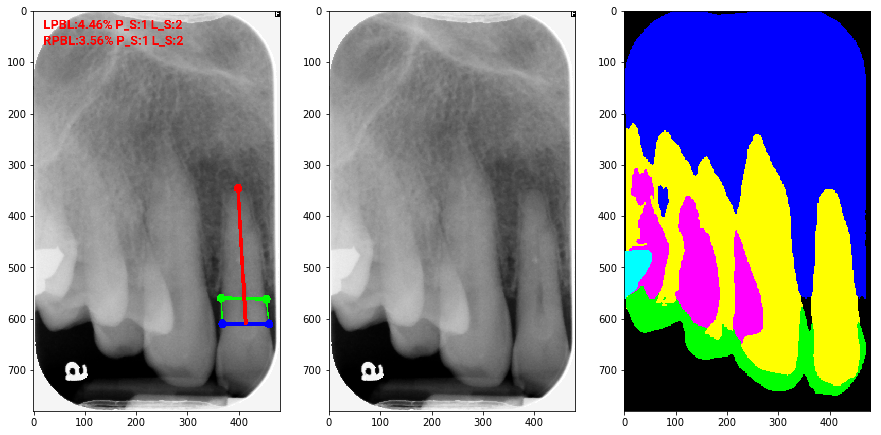

Predict got different value


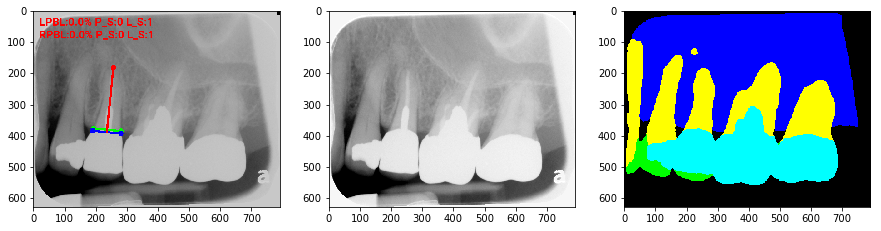

Predict got different value


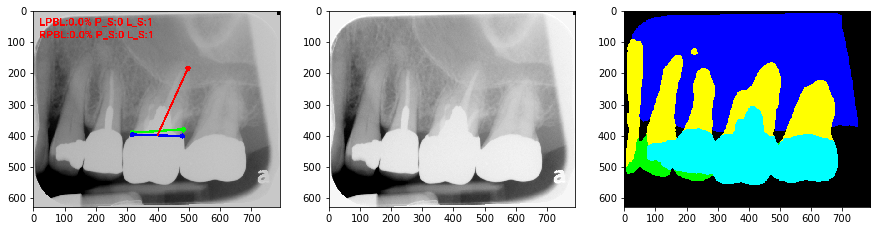

Predict got different value


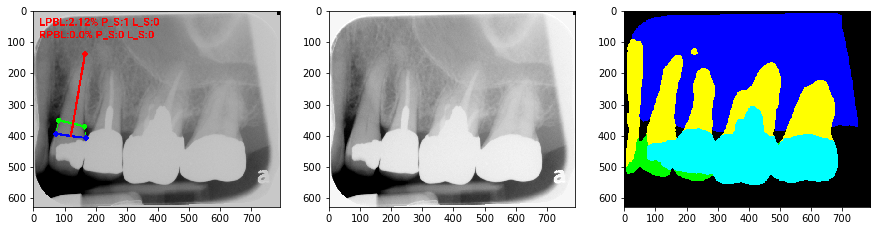

Predict got different value


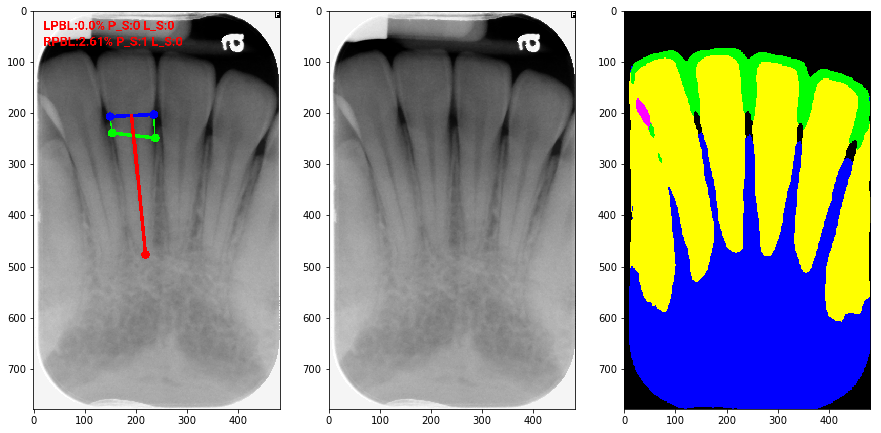

Predict got different value


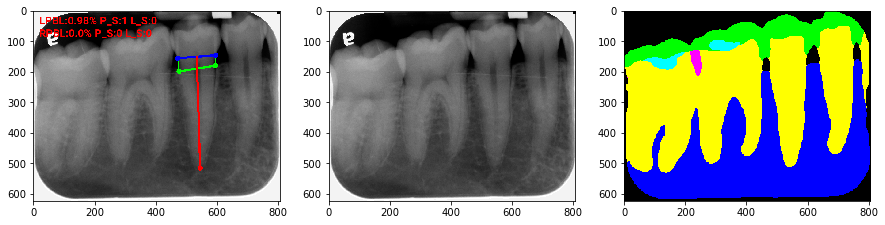

Predict got different value


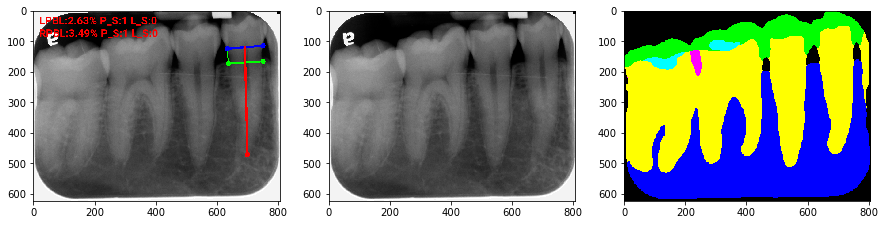

Predict got different value


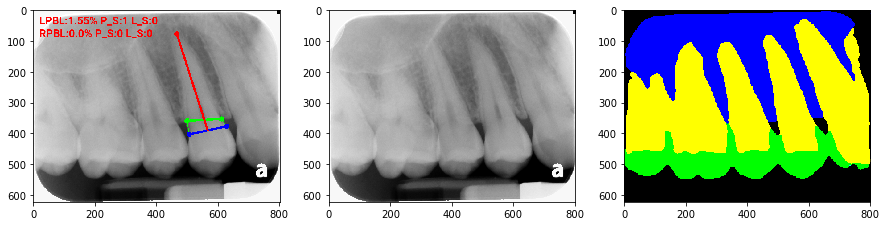

Predict got different value


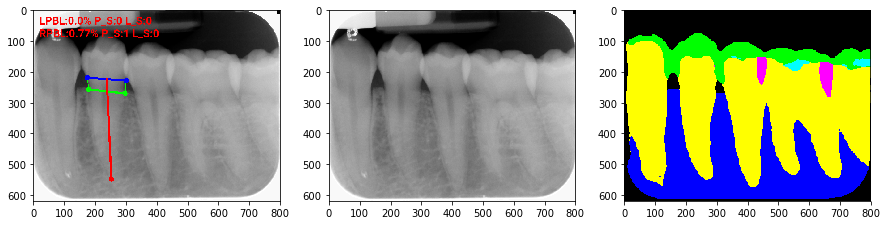

Predict got different value


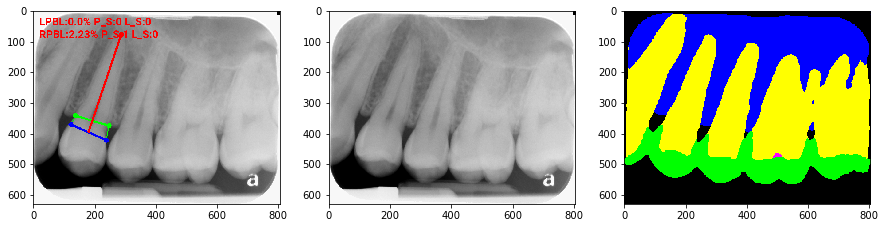

Predict got different value


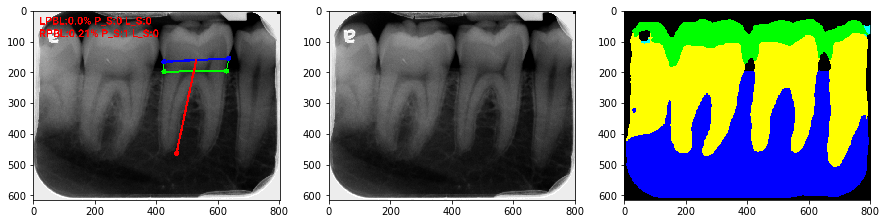

Predict got different value


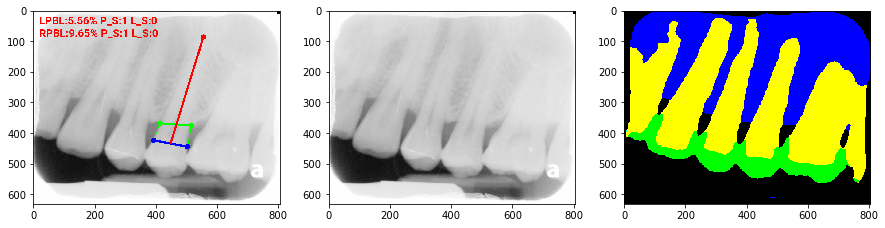

Predict got different value


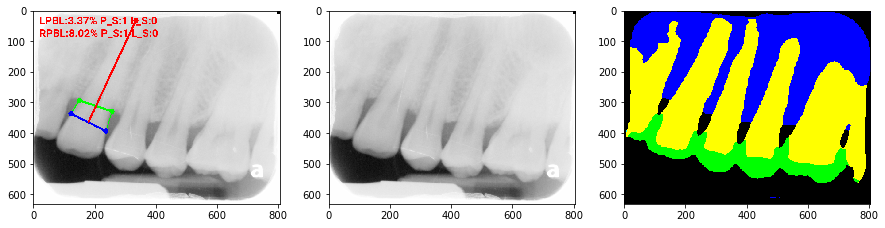

Predict got different value


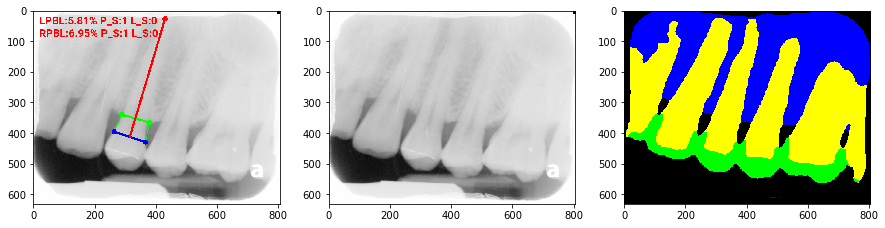

Predict got different value


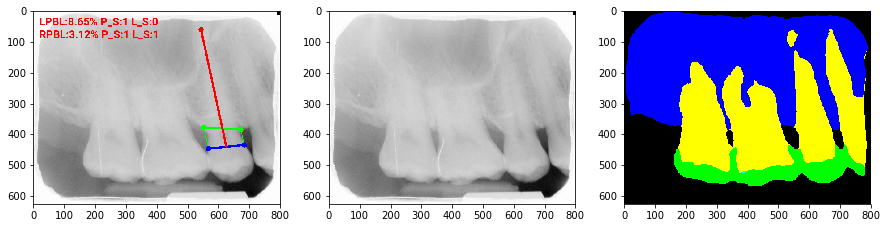

Predict got different value


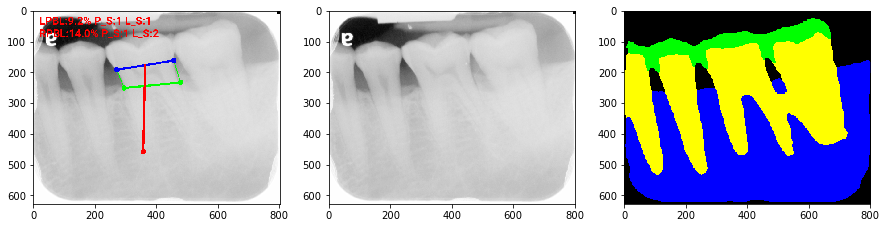

Predict got different value


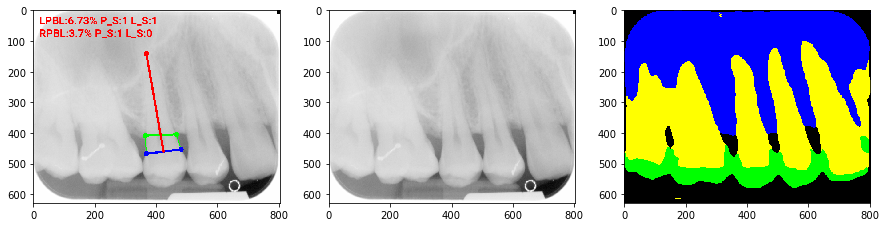

Predict got different value


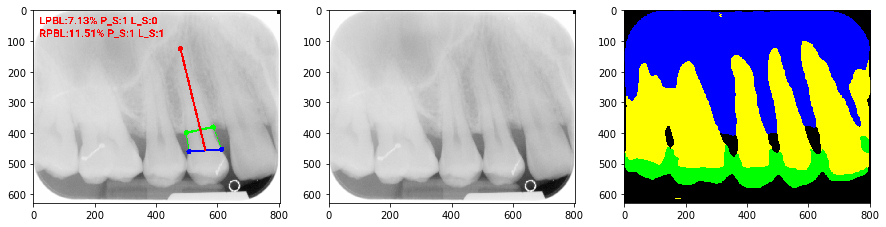

Predict got different value


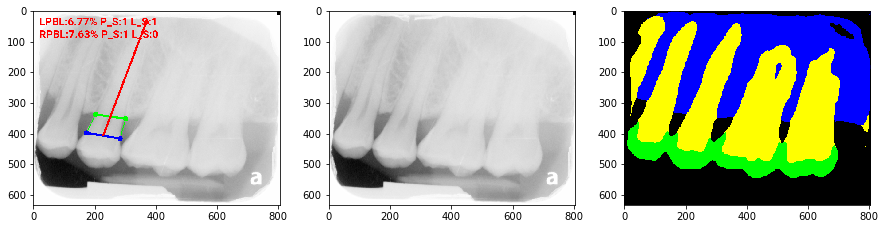

Predict got different value


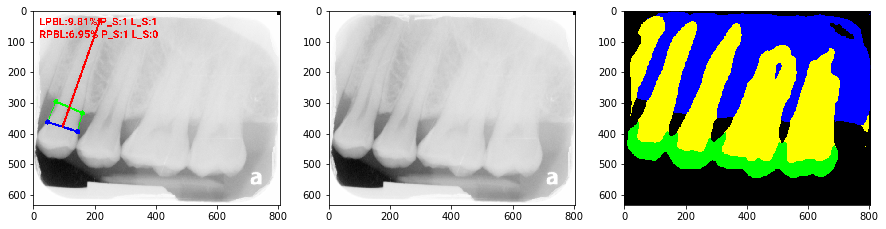

Predict got different value


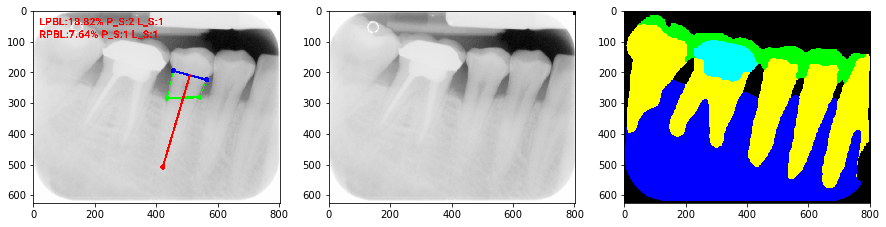

Predict got different value


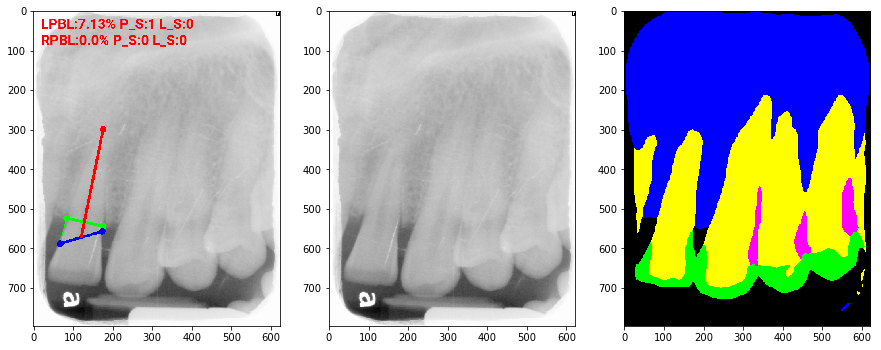

Predict got different value


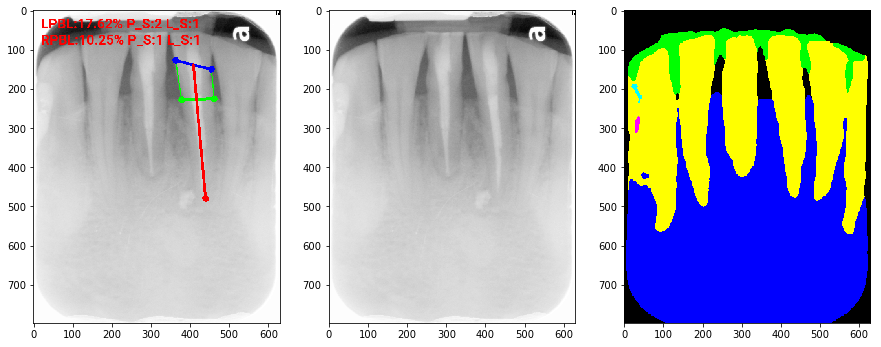

Predict got different value


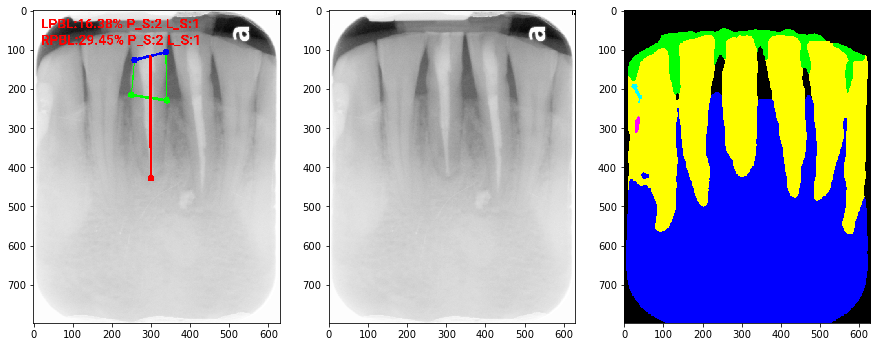

Predict got different value


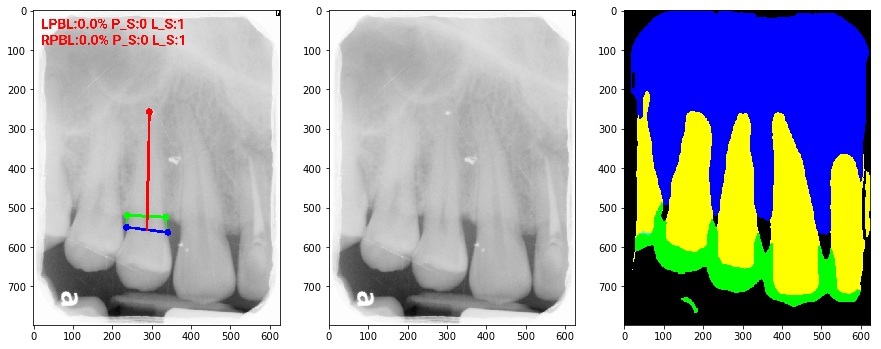

Predict got different value


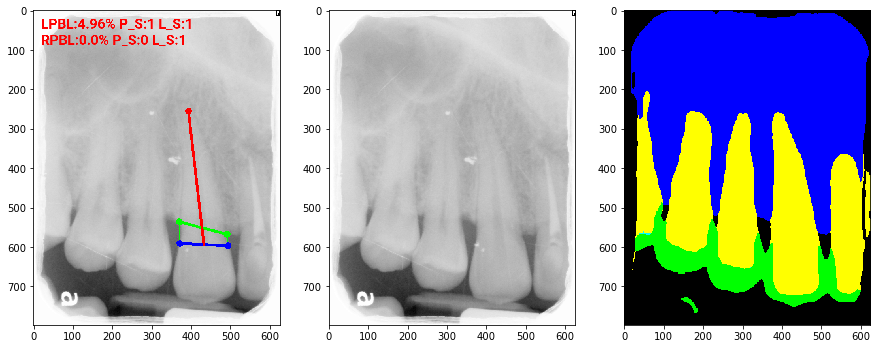

Predict got different value


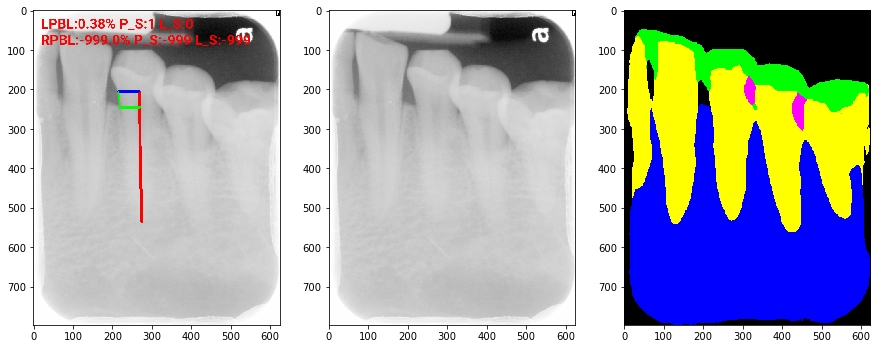

Predict got different value


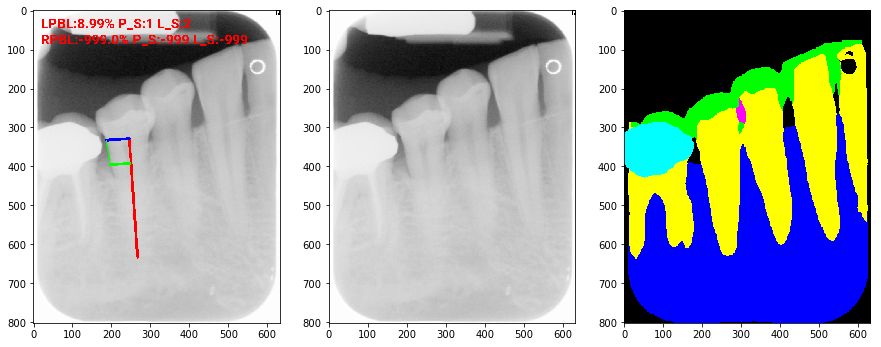

Predict got different value


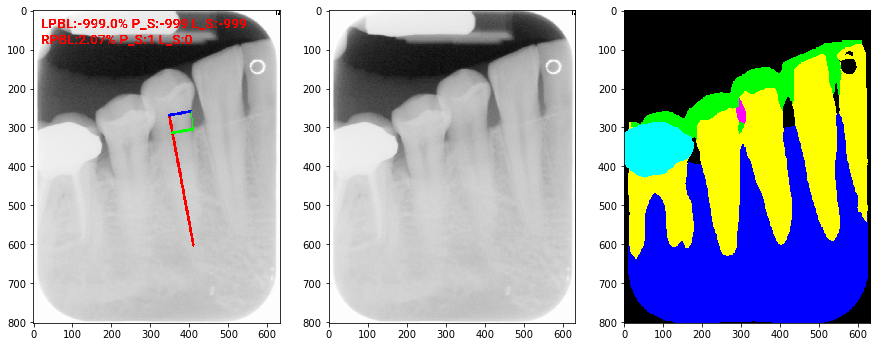

Predict got different value


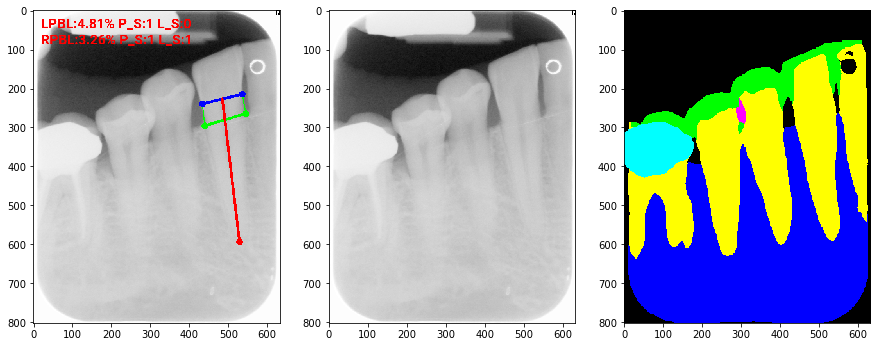

Predict got different value


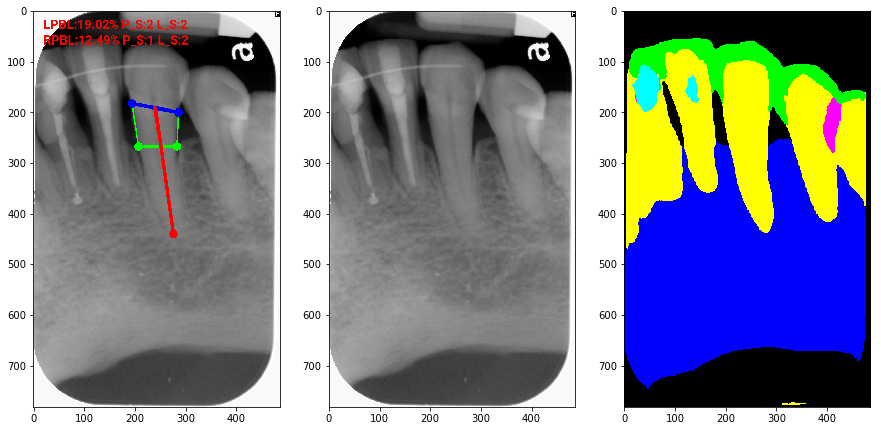

Predict got different value


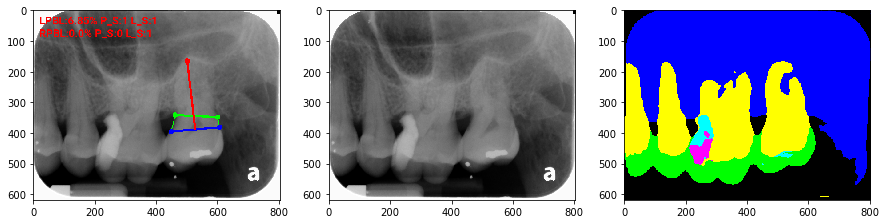

Predict got different value


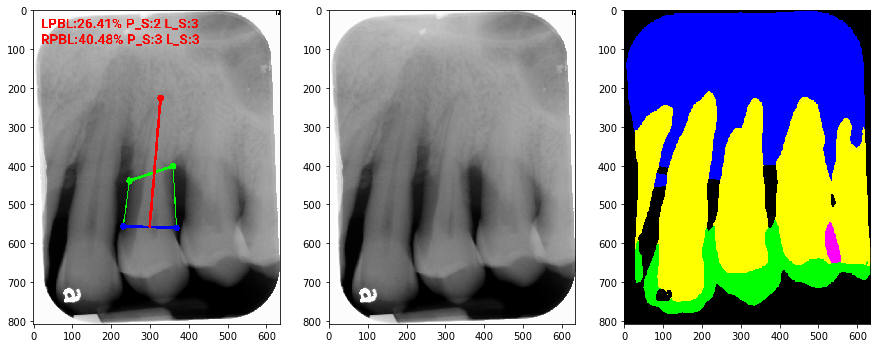

Predict got different value


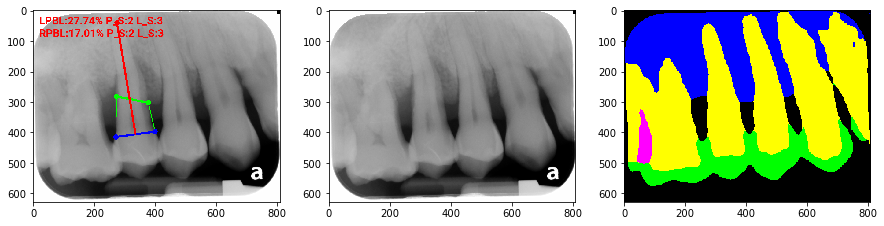

Predict got different value


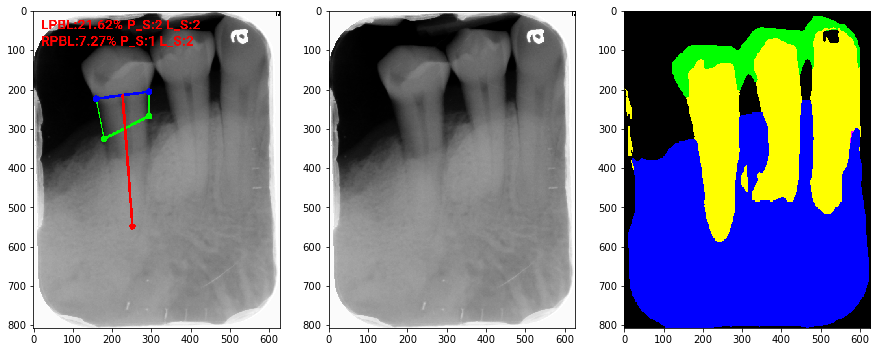

Predict got different value


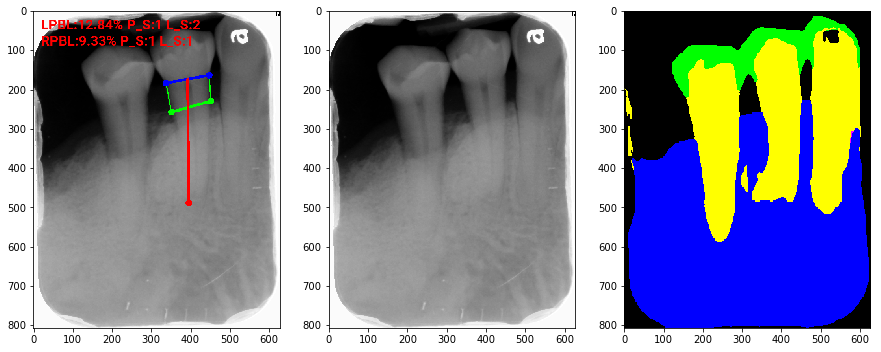

In [17]:
#Show the difference between the prediction and the doctor's judgment
o_img_folder = os.path.join(parent_folder_path,'1_o_image')
seg_img_folder = os.path.join(parent_folder_path,'1_seg_image')
path = os.path.join(parent_folder_path,'6_result_with_label')
image_path_list = glob.glob(path+'/*.PNG')
image_path_list.sort()

print(len(image_path_list))
count = 0
for index,image_path in tqdm(enumerate(image_path_list),total=len(image_path_list)):
    image_name = get_name_from_path(image_path,False)
    
    if image_name[-1] == '4':
        o_image_name = image_name[:-7]
        print('Predict got different value')
        o_image_path = os.path.join(o_img_folder,o_image_name+'.PNG')
        seg_image_path = os.path.join(seg_img_folder,o_image_name+'.PNG')
        plt.figure(figsize=(15,15))
        plt.subplot(131)
        plt.imshow(cv2.cvtColor(cv2.imread(image_path), cv2.COLOR_BGR2RGB))
        plt.subplot(132)
        plt.imshow(cv2.imread(o_image_path,0),cmap='gray')
        plt.subplot(133)
        plt.imshow(cv2.cvtColor(cv2.imread(seg_image_path), cv2.COLOR_BGR2RGB))
        plt.show()
        count +=1
    else:
        pass

In [18]:
count = 84
print(count)

84


In [19]:
# #Show the difference between the prediction and the doctor's judgment
# o_img_folder = os.path.join(parent_folder_path,'1_o_image')
# seg_img_folder = os.path.join(parent_folder_path,'1_seg_image')
# path = os.path.join(parent_folder_path,'6_result_with_label')
# image_path_list = glob.glob(path+'/*.PNG')
# image_path_list.sort()

# print(len(image_path_list))
# count = 0
# for index,image_path in tqdm(enumerate(image_path_list),total=len(image_path_list)):
#     image_name = get_name_from_path(image_path,False)
#     if image_name[-1] == 'f':
#         o_image_name = image_name[:-9]
#         print(o_image_name)
#         print('Predict got different value')
#         o_image_path = os.path.join(o_img_folder,o_image_name+'.PNG')
#         seg_image_path = os.path.join(seg_img_folder,o_image_name+'.PNG')
#         plt.figure(figsize=(15,15))
#         plt.subplot(131)
#         plt.imshow(cv2.cvtColor(cv2.imread(image_path), cv2.COLOR_BGR2RGB))
#         plt.subplot(132)
#         plt.imshow(cv2.imread(o_image_path,0),cmap='gray')
#         plt.subplot(133)
#         plt.imshow(cv2.cvtColor(cv2.imread(seg_image_path), cv2.COLOR_BGR2RGB))
#         plt.show()
#         count +=1
#     else:
#         pass

In [20]:
#count = 84
print(count)

84


In [21]:
path = os.path.join(parent_folder_path,'4_seg_img_with_cej')
image_path_list1 = glob.glob(path+'/*.PNG')
image_path_list1.sort()

path = os.path.join(parent_folder_path,'5_pattern_detection_result')
image_path_list2 = glob.glob(path+'/*.PNG')
image_path_list2.sort()

In [22]:
print(len(image_path_list1))
print(len(image_path_list2))

478
473


In [23]:
# for index,path in enumerate(image_path_list1):
#     if 'NN__191111_145307_24202' in path:
#         plt.imshow(cv2.imread(path))
#         plt.show()
#     else:
#         pass

In [24]:
# for index,path in enumerate(image_path_list2):
#     if 'NN__191111_145307_24202' in path:
#         plt.imshow(cv2.cvtColor(cv2.imread(path),cv2.COLOR_BGR2RGB))
#         plt.show()
#     else:
#         pass